# Sales Prediction using XGB algorithm

In [7]:
import pandas as pd
import os
from matplotlib import pyplot as plt 
from shapely.geometry import Point
# import geopandas as gpd
# from geopandas import GeoDataFrame
import boto3
import matplotlib.image as mpimg
import numpy as np
import csv
import xgboost as xgb
# from tpot import TPOTRegressor
from sklearn.metrics import mean_squared_error
from math import sqrt
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.metrics import mean_squared_error
import itertools
import random
random.seed(7)

## Define functions

In [8]:
def plot_blu(target_bar_id, blu, new_bar_dict2):
    for key in blu:
        from pylab import rcParams
        a = new_bar_dict2[key][0]
        target = new_bar_dict2[target_bar_id][0]        
        plt.plot(target['sales_before_tax'],'r')
        plt.plot(a['sales_before_tax'],'b')
        plt.legend(('My Bar: '+target_bar_id,str(key)))
        plt.show()

In [9]:
def bar_finder_rmseccoef(target_bar_id,bar_dict):
    rmse_list = []
    ccoef_list = []
    blu = []
    target = bar_dict[target_bar_id][0]
    bar_list = [*bar_dict]
    bar_list = [i for i in bar_list if i != target_bar_id]
    for i, key in enumerate(bar_list):
        a = new_bar_dict2[key][0]
        rmse = sqrt(mean_squared_error(target['sales_before_tax'].values, a['sales_before_tax'].values))
        ccoef = 100*np.corrcoef(target['sales_before_tax'].values.T,a['sales_before_tax'].values.T)[0,1]
        rmse_list.append(rmse)
        ccoef_list.append(ccoef)
        blu.append(key)
    rmse_list_norm = 1-(np.asarray(rmse_list1))/max(np.asarray(rmse_list1))
    ccoef_list_norm = np.asarray(ccoef_list1)/max(np.asarray(ccoef_list1))

    rmseccoef = list(rmse_list_norm + 0.2*ccoef_list_norm)
    blu = [x for _,x in sorted(zip(rmseccoef,blu))]
    blu.reverse()

    return blu

In [10]:
def bar_finder_ccoef(target_bar_id,bar_dict):
    rmse_list = []
    ccoef_list = []
    blu = []
    target = bar_dict[target_bar_id][0]
    bar_list = [*bar_dict]
    bar_list = [i for i in bar_list if i != target_bar_id]
    for i, key in enumerate(bar_list):
        a = new_bar_dict2[key][0]
        rmse = sqrt(mean_squared_error(target['sales_before_tax'].values, a['sales_before_tax'].values))
        ccoef = 100*np.corrcoef(target['sales_before_tax'].values.T,a['sales_before_tax'].values.T)[0,1]
        rmse_list.append(rmse)
        ccoef_list.append(ccoef)
        blu.append(key)
    blu = [x for _,x in sorted(zip(ccoef_list,blu))]
    blu.reverse()

    return blu, ccoef_list, rmse_list


In [11]:
def bar_finder_rmse(target_bar_id,bar_dict):
    rmse_list = []
    ccoef_list = []
    blu = []
    target = bar_dict[target_bar_id][0]
    bar_list = [*bar_dict]
    bar_list = [i for i in bar_list if i != target_bar_id]
    for i, key in enumerate(bar_list):
        a = new_bar_dict2[key][0]
        rmse = sqrt(mean_squared_error(target['sales_before_tax'].values, a['sales_before_tax'].values))
        ccoef = 100*np.corrcoef(target['sales_before_tax'].values.T,a['sales_before_tax'].values.T)[0,1]
        rmse_list.append(rmse)
        ccoef_list.append(ccoef)
        blu.append(key)
    blu = [x for _,x in sorted(zip(rmse_list,blu))]
    return blu, ccoef_list, rmse_list


In [12]:
def train_xgb(df_train, df_test, aa):
    X_tr = df_train[aa]
    y_tr = df_train[target]
    scaler = preprocessing.RobustScaler(quantile_range=(25.0, 75.0)).fit(X_tr)
    X_tr = scaler.transform(X_tr)   
    # clf = xgb.XGBRegressor(learning_rate=0.1, seed = 4,max_depth=2, min_child_weight=4, n_estimators=100).fit(X_tr,y_tr)
    clf = xgb.XGBRegressor().fit(X_tr,y_tr)

#     test = df_test[df_test['bar_id']== int(last_bar_list[0])]
    test = df_test

    test = test.dropna()
    test = test[~test.isin(['nan']).any(axis=1)]
    y_ts = test[target]
    test = test[aa]
    X_ts = test
    X_ts = scaler.transform(X_ts)
    predictions = clf.predict(X_ts)
    test['predicted_sale'] = predictions
    rmse = sqrt(mean_squared_error(y_ts['sales_before_tax'].values, predictions))
    ccoef = 100*np.corrcoef(y_ts['sales_before_tax'].values.T,predictions.T)[0,1]
    rmse_list.append(rmse)
    ccoef_list.append(ccoef)
    
    print('RMS Error: ',rmse)
    print('Corr. Coef. = ',ccoef) 
    return rmse


In [13]:
def get_file_path_list(path):  
    full_path_list = []
    for path, subdirs, files in os.walk(path):
        for filename in files:
            f = os.path.join(path, filename)
            full_path_list.append(f)
    return full_path_list

## Read weather info

In [14]:
file_names = get_file_path_list('Weather/')

In [15]:
df = pd.DataFrame()
cols = ['Date/Time','Month','Max Temp (°C)','Min Temp (°C)','Mean Temp (°C)','Total Precip (mm)','Snow on Grnd (cm)']
for file_name in file_names:
    dftemp = pd.read_csv(file_name)
    dftemp = dftemp[cols]
    df = pd.concat([df,dftemp], axis=0)
    
df[['Total Precip (mm)','Snow on Grnd (cm)']] = df[['Total Precip (mm)','Snow on Grnd (cm)']].fillna(value=0)
df = df.fillna(df.mean())
df=df.rename(columns = {'Date/Time':'order_time'})
df['order_time'] = pd.to_datetime(df['order_time'])
df['day_of_week'] = df['order_time'].dt.weekday_name
df = df[df['order_time'].isin(pd.date_range(start='20171101', end='20190304'))]
df.set_index('order_time', inplace=True)
df.sort_index(inplace=True)
df.drop_duplicates(inplace=True)

In [16]:
df = df.replace(['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'], 
                     [1, 2, 3, 4, 5,6,7]) 

In [17]:
df.tail(200)

,Month,Max Temp (°C),Min Temp (°C),Mean Temp (°C),Total Precip (mm),Snow on Grnd (cm),day_of_week
order_time,,,,,,,
2018-08-17,8,27.4,21.4,24.4,26.5,0.0,5
2018-08-18,8,24.5,19.8,22.2,0.0,0.0,6
2018-08-19,8,24.6,18.8,21.7,0.0,0.0,7
2018-08-20,8,25.2,19.8,22.5,0.0,0.0,1
2018-08-21,8,25.8,20.2,23.0,38.8,0.0,2
2018-08-22,8,22.2,16.3,19.2,0.2,0.0,3
2018-08-23,8,27.3,15.7,21.5,0.0,0.0,4
2018-08-24,8,26.7,16.8,21.8,0.0,0.0,5
2018-08-25,8,25.2,20.4,22.8,8.8,0.0,6


## Enter hockey games info

In [19]:
## New Hockey games added
events = "7-1-2018,5-25-2018,4-1-2018,9-3-2018,10-8-2018,11-11-2018,2-19-2018,3-17-2018,8-4-2018,6-29-2018,7-1-2019,5-25-2019,4-21-2019,9-2-2018,10-14-2019,11-11-2019,2-18-2019,3-17-2019,8-4-2019,6-29-2019,9-18-2018,9-19-2018,9-21-2018,9-22-2018,9-24-2018,9-26-2018,9-28-2018,9-29-2018,10-3-2018,10-6-2018,10-7-2018,10-9-2018,10-11-2018,10-13-2018,10-15-2018,10-18-2018,10-20-2018,10-24-2018,10-27-2018,10-29-2018,11-1-2018,11-3-2018,11-6-2018,11-9-2018,11-10-2018,11-13-2018,11-15-2018,11-16-2018,11-19-2018,11-21-2018,11-23-2018,11-24-2018,11-26-2018,11-28-2018,12-1-2018,12-4-2018,12-6-2018,12-8-2018,12-11-2018,12-13-2018,12-15-2018,12-18-2018,12-20-2018,12-22-2018,12-23-2018,12-28-2018,12-29-2018,1-3-2019,1-5-2019,1-7-2019,1-10-2019,1-12-2019,1-14-2019,1-17-2019,1-18-2019,1-20-2019,1-23-2019,2-1-2019,2-2-2019,2-4-2019,2-6-2019,2-9-2019,2-10-2019,2-12-2019,2-14-2019,2-16-2019,2-19-2019,2-21-2019,2-23-2019,2-25-2019,2-27-2019,2-28-2019,3-2-2019,3-4-2019,3-6-2019,3-9-2019,3-11-2019,3-13-2019,3-15-2019,3-16-2019,3-19-2019,3-20-2019,3-23-2019,3-25-2019,3-27-2019,3-30-2019"
# events = "7-1-2018,5-25-2018,4-1-2018,9-3-2018,10-8-2018,11-11-2018,2-19-2018,3-17-2018,8-4-2018,6-29-2018,7-1-2019,5-25-2019,4-21-2019,9-2-2018,10-14-2019,11-11-2019,2-18-2019,3-17-2019,8-4-2019,6-29-2019"
events = [events.split(',')]
df['events']=0
for d in events:
    date = pd.to_datetime(d)
for d in date:
    df.at[d,'events']=1

In [20]:
df_event = df 
df_event.sort_index(inplace=True)
df_event = df_event.reset_index()
df_event = df_event[df_event['order_time'].isin(pd.date_range(start='20171101', end='20190304'))]
df_event.set_index('order_time', inplace=True)


## Also read the sales data

In [23]:
file_names = get_file_path_list('Data')

df2 = pd.DataFrame()
cols = ['bar_id','order_time','sales_before_tax']
for file_name in file_names:
    dftemp = pd.read_parquet(file_name, engine='pyarrow')
    dftemp = dftemp[cols]
    for barid in dftemp['bar_id'].unique():
        dftemp_sub = dftemp[dftemp['bar_id']==barid]
        dftemp_sub.set_index('order_time', inplace=True)
        dftemp_sub = dftemp_sub.resample("d").agg({'sales_before_tax':np.sum,'bar_id':'last'})
        df2 = pd.concat([df2,dftemp_sub], axis=0)

In [24]:
df = df2.reset_index()
df = df[df['order_time'].isin(pd.date_range(start='20171101', end='20190304'))]
df.set_index('order_time', inplace=True)

In [25]:
df.dropna(inplace= True)
df['bar_id'] = df['bar_id'].astype(int)
bar_list = [int(i) for i in df.bar_id.unique() if str(i) != 'nan']
print(bar_list)
bar_list = list(set(bar_list))

[2691, 4679, 1278, 4144, 7015, 2869, 4151, 1279, 4683, 1159, 1154, 4676, 4678, 1155, 1173, 7028, 4677, 4241, 2282, 2843, 1276, 1177, 3379, 2871, 1157, 4328, 2566, 1179, 3504, 1270, 1269, 4054, 2889, 1170, 2890, 2868, 7213, 2619, 3783, 2476, 4682, 3162, 2449, 2453, 4143, 3578, 2870, 2441, 2818, 4242, 2748, 7268, 5187, 2483, 4684, 17650, 7127, 4685, 12543, 17125, 10840, 7468, 4686, 10526, 17271, 17200, 17199, 19088, 19142, 19195, 4689, 12573, 7206, 7199, 10833, 17895, 17147, 3002, 2609, 16988, 12536, 12248, 16984, 10834, 16987, 12258, 7469, 10917, 13028, 19513, 19521, 19509, 23208, 13023, 19205, 7102, 7100, 7106, 17014, 19201, 11773]


In [26]:
bar_dict = {str(k): [] for k in (bar_list)}
for bar in bar_list:
    bar_1 = df[df['bar_id']== bar]
    bar_1 = bar_1.resample("d").agg({'sales_before_tax':np.sum,'bar_id':'last'})
    bar_1.sort_index(inplace=True)
    bar_1.dropna(inplace= True)
    bar_1['bar_id'] = bar_1['bar_id'].astype(int)
    bar_dict[str(bar)].append(bar_1)

In [27]:
bar_dict2 = bar_dict.copy()
for key in bar_dict.keys():
    a = bar_dict[key][0]
    a = a.reset_index()
    b = pd.Timestamp(2017,12,29) <= a.loc[0,['order_time']]
    if (b.any() or len(a)< 460):
#     if b.any():
        del bar_dict2[key]

In [28]:
new_bar_list = [*bar_dict2]

## Interpolate to have data for all days between min and max dates for each bar

In [29]:
min_date = []
max_date = []

new_bar_dict = {str(k): [] for k in (new_bar_list)}

for bar in new_bar_list:
    bar_1 = bar_dict2[bar][0]
    idx = pd.date_range(bar_1.index[0], bar_1.index[-1])
    bar_1.index = pd.DatetimeIndex(bar_1.index)
    bar_1 = bar_1.reindex(idx, fill_value=np.nan)
    bar_1 = bar_1.apply(pd.to_numeric)
    bar_1 = bar_1.fillna(bar_1.mean())
    mindate = bar_1.index[0]
    maxdate = bar_1.index[-1]   
    min_date.append(mindate)
    max_date.append(maxdate)
    new_bar_dict[str(bar)].append(bar_1)

In [30]:
new_bar_dict2 = new_bar_dict.copy()
for key in new_bar_dict.keys():
    a = new_bar_dict[key][0]
    if len(a)< 489:
        del new_bar_dict2[key]

In [31]:
last_bar_list = [*new_bar_dict2]

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


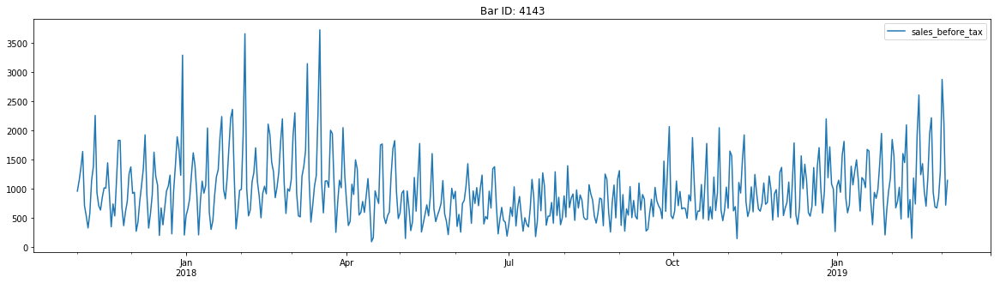

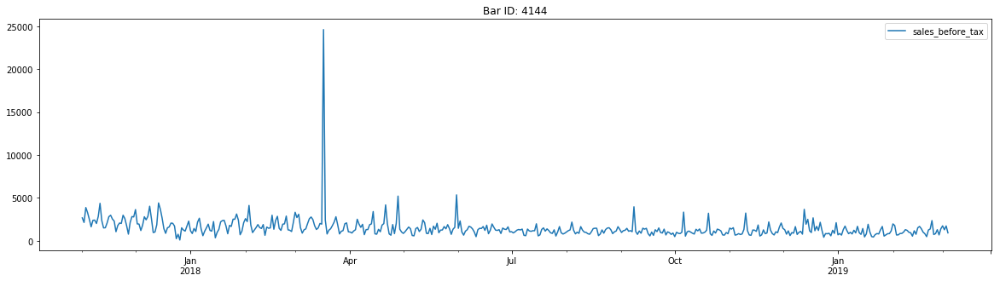

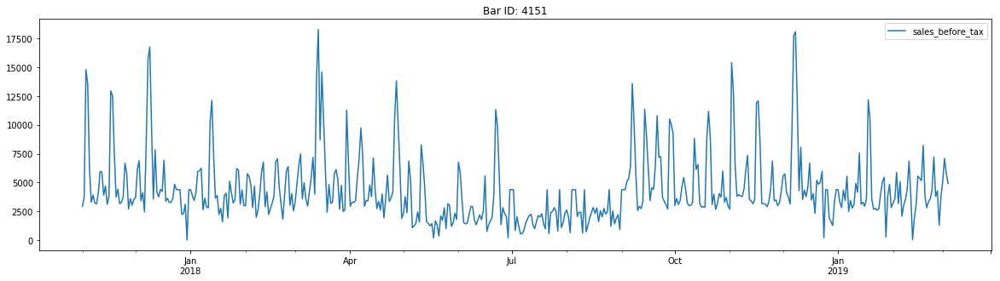

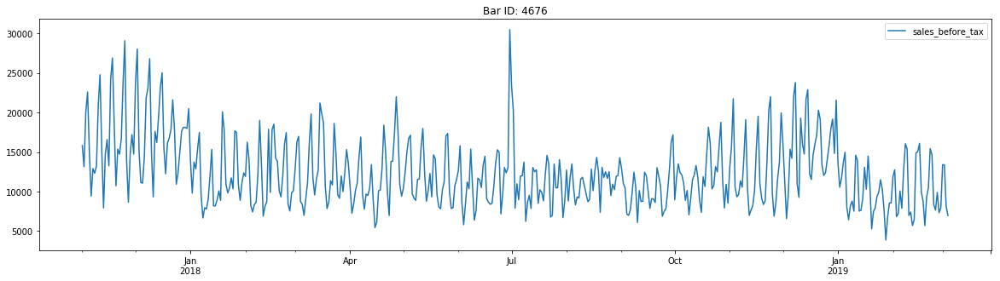

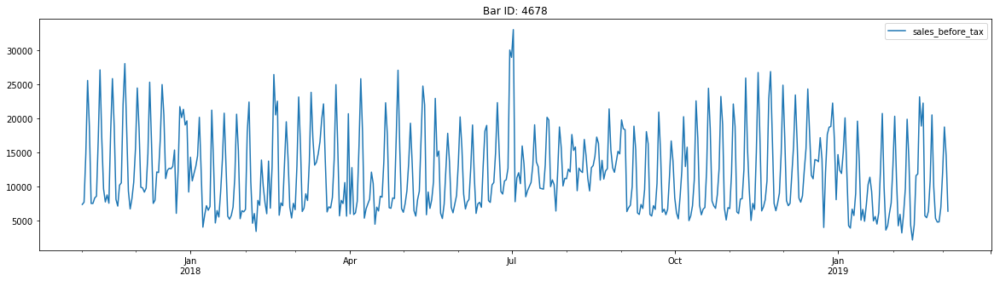

...

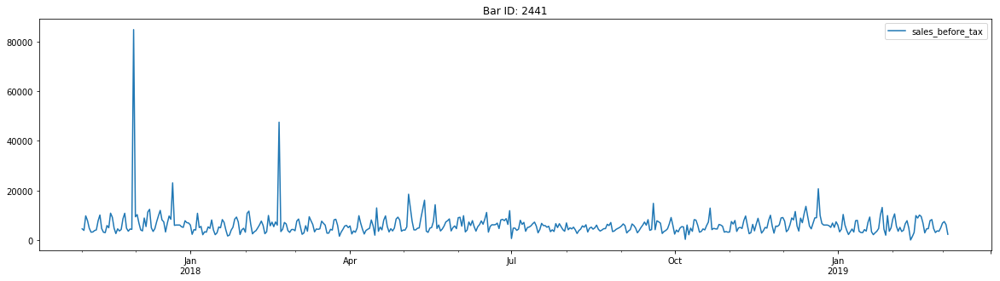

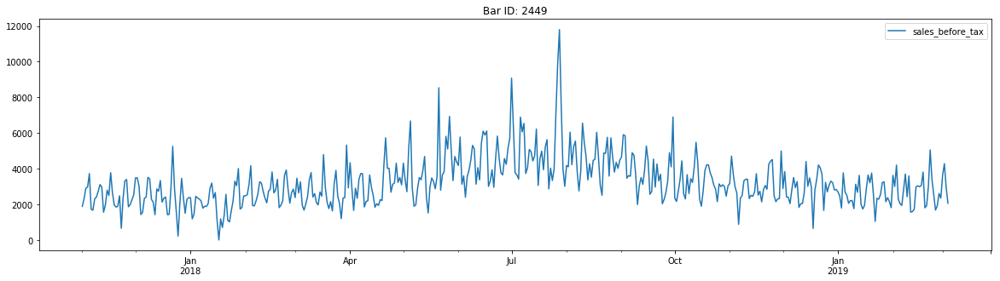

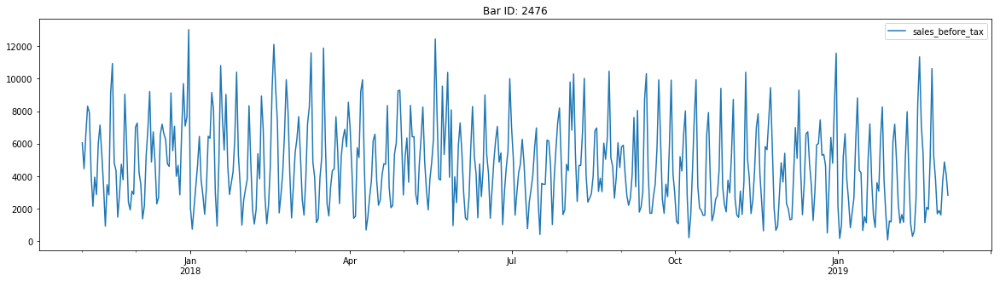

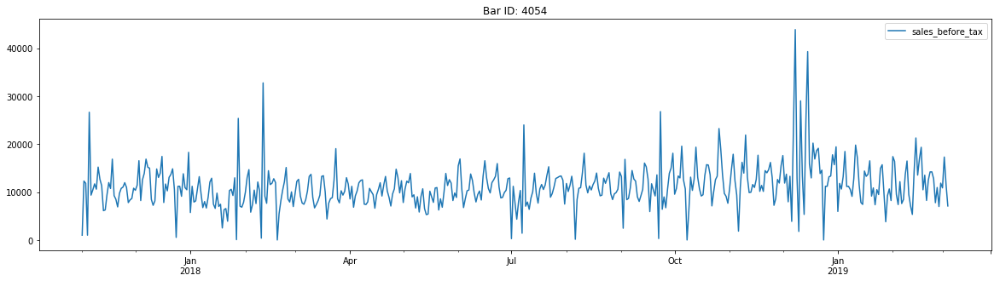

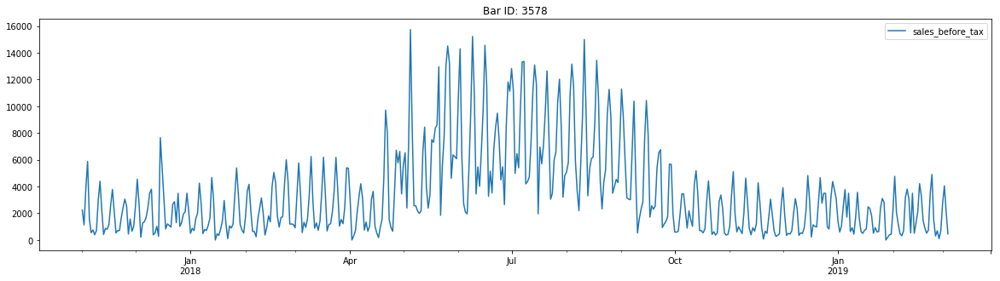

In [33]:
for key in new_bar_dict2.keys():
    from pylab import rcParams
    a = new_bar_dict2[key][0]
    rcParams['figure.figsize'] = 20, 5
    a.plot(y='sales_before_tax', use_index=True, title= 'Bar ID: '+key)

In [34]:
dffinal = pd.DataFrame()
cols = ['bar_id','order_time','sales_before_tax']
for key in new_bar_dict2.keys():
    a = new_bar_dict2[key][0]
    dffinal = pd.concat([dffinal,a], axis=0)

## Include location data also

In [35]:
dffinal['bar_id'] = dffinal['bar_id'].astype(int)
dffinal['lat'] = 0
dffinal['lon'] = 0
dffinal.head()

,sales_before_tax,bar_id,lat,lon
2017-11-01,962.03,4143,0,0
2017-11-02,1138.20,4143,0,0
2017-11-03,1363.50,4143,0,0
2017-11-04,1639.77,4143,0,0
2017-11-05,712.60,4143,0,0


In [36]:
csvfile = 'lat.csv'
maps = pd.read_csv(csvfile)
maps2 = maps[['lat','lng','id']]

maps2 = maps2[maps2['id'].isin(last_bar_list)]
maps2 = maps2.reindex()
maps2['lat'] = maps2['lat']-43
maps2['lng'] = maps2['lng']+79

In [38]:
for bar in last_bar_list:
    dffinal['lat'][dffinal['bar_id']==int(bar)] = maps2['lat'][maps2['id']== int(bar)].values
    dffinal['lon'][dffinal['bar_id']==int(bar)] = maps2['lng'][maps2['id']== int(bar)].values

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app
/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel

## Merge all data frames with all attributes in a dictionary

In [41]:
bar_dict_all_attributes = {str(k): [] for k in (last_bar_list)}
df_last = pd.DataFrame()

for bar in last_bar_list:
    bar_1 = dffinal[dffinal['bar_id']== int(bar)]
    bar_1 = pd.concat([bar_1,df_event], axis=1)
    bar_1.sort_index(inplace=True)
    bar_1.dropna(inplace= True)
    bar_1['bar_id'] = bar_1['bar_id'].astype(int)
    bar_dict_all_attributes[str(bar)].append(bar_1)
    df_last = pd.concat([df_last,bar_1], axis=0)

In [61]:
def write_to_s3(fobj, bucket, key):
    return boto3.Session().resource('s3').Bucket(bucket).Object(key).upload_fileobj(fobj)

def upload_to_s3(bucket, channel, filename):
    fobj=open(filename, 'rb')
    key = channel+'/'+filename
    url = 's3://{}/{}'.format(bucket, key)
    print('Writing to {}'.format(url))
    write_to_s3(fobj, bucket, key)     
    return(url)

In [62]:
df_last.to_csv('df_last.csv', index=True)
bucket = 'weissbeerger-bucket'

s3_test_loc = upload_to_s3(bucket = bucket, channel = 'data', filename = 'df_last.csv')

Writing to s3://weissbeerger-bucket/data/df_last.csv


In [43]:
date_margin = '2018-12-24'
df_train = df_last[(df_last.index <= date_margin)]
df_test = df_last[(df_last.index > date_margin)]


In [54]:
df_train.to_csv('df_train.csv', index=False)
df_test.to_csv('df_val.csv', index=False)

df_train.to_csv('df_train_ind.csv', index=True)
df_test.to_csv('df_val_ind.csv', index=True)

# ML modeling starts here

## No bar ID in the inputs

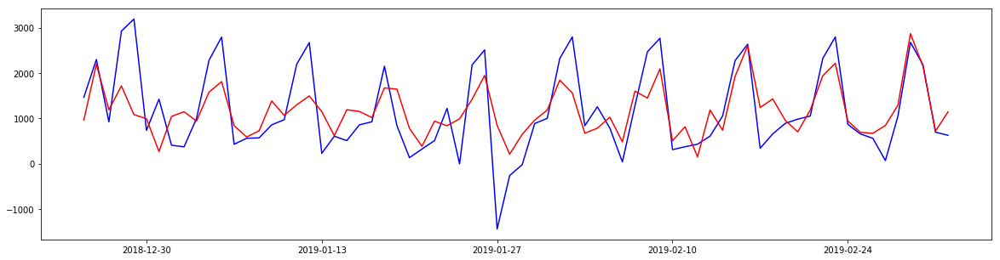

In [45]:
target = ['sales_before_tax']
columns = df_train.columns.tolist()
remove = ['sales_before_tax','bar_id']
aa = [x for x in columns if x not in remove]

X_tr = df_train[aa]
y_tr = df_train[target]
scaler = preprocessing.RobustScaler(quantile_range=(25.0, 75.0)).fit(X_tr)
X_tr = scaler.transform(X_tr)   
# clf = xgb.XGBRegressor(learning_rate=0.1, seed = 4,max_depth=2, min_child_weight=4, n_estimators=100).fit(X_tr,y_tr)
clf = xgb.XGBRegressor().fit(X_tr,y_tr)
test = df_test[df_test['bar_id']== int(last_bar_list[0])]
test = test.dropna()
test = test[~test.isin(['nan']).any(axis=1)]
y_ts = test[target]
test = test[aa]
X_ts = test
X_ts = scaler.transform(X_ts)
predictions = clf.predict(X_ts)
test['predicted_sale'] = predictions
plt.plot(test['predicted_sale'],'b' )
plt.plot(y_ts['sales_before_tax'],'r')
plt.show()

## Predict all bars, create new DF with predictions, and corresponding sales from last year

In [57]:
train_ind = pd.read_csv('df_train_ind.csv', index_col= 'order_time')
val_ind  = pd.read_csv('df_val_ind.csv', index_col= 'order_time')

In [51]:
train = pd.read_csv('df_train.csv')
val  = pd.read_csv('df_val.csv')

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


RMS Error:  669.1733026863362
Corr. Coef. =  73.5578714000806


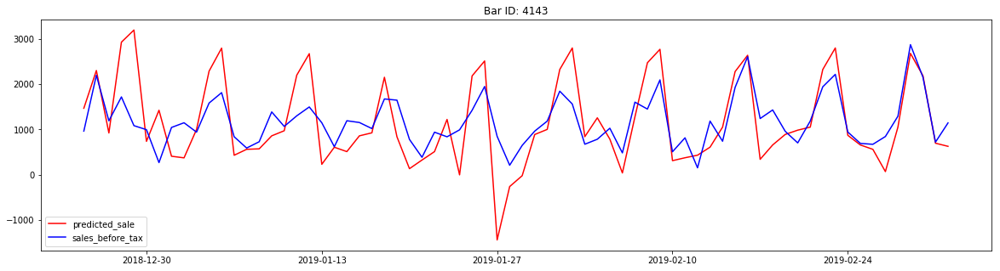

RMS Error:  891.7007253759444
Corr. Coef. =  61.02612535514959


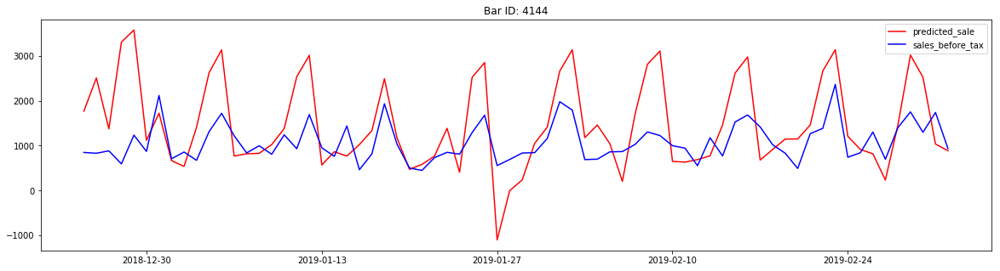

RMS Error:  3025.024328287291
Corr. Coef. =  37.612809197507644


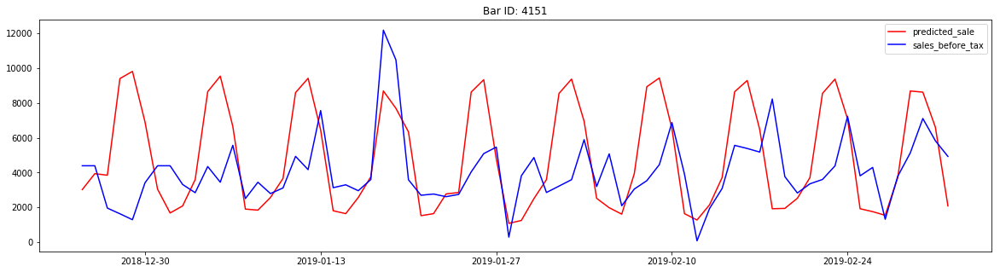

RMS Error:  3726.9522469027584
Corr. Coef. =  69.8758030029842


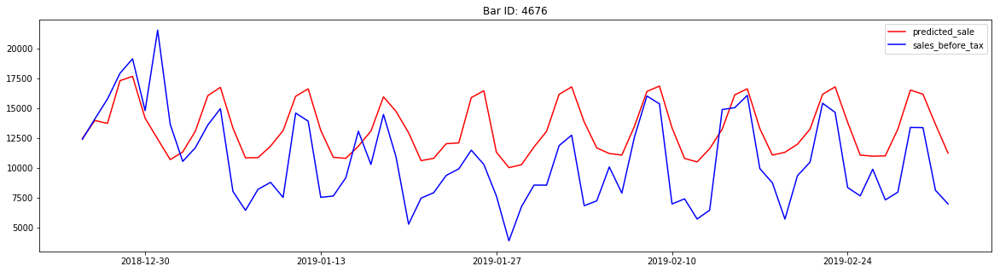

RMS Error:  4189.180394613132
Corr. Coef. =  74.404762414767


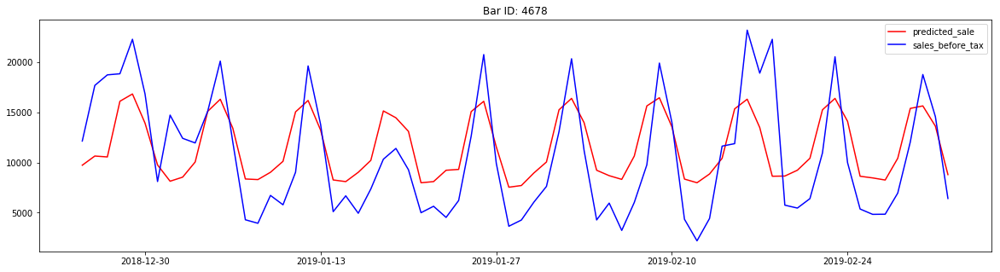

RMS Error:  2752.2769972671194
Corr. Coef. =  84.0730341088264


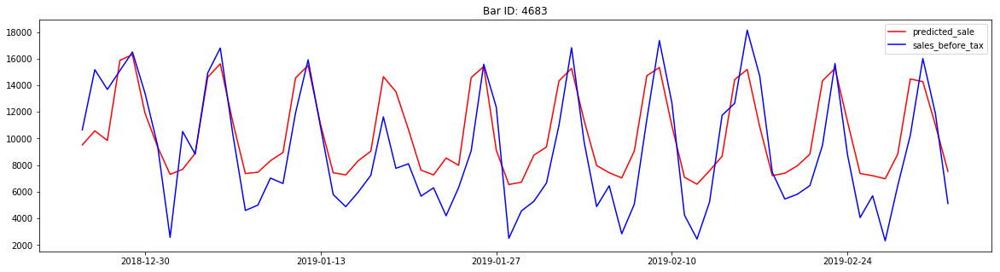

RMS Error:  2844.577507504039
Corr. Coef. =  58.57098792499613


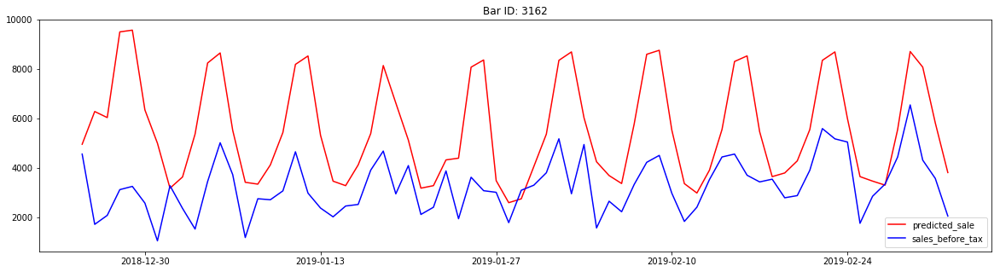

RMS Error:  4300.887242862363
Corr. Coef. =  86.21454012646757


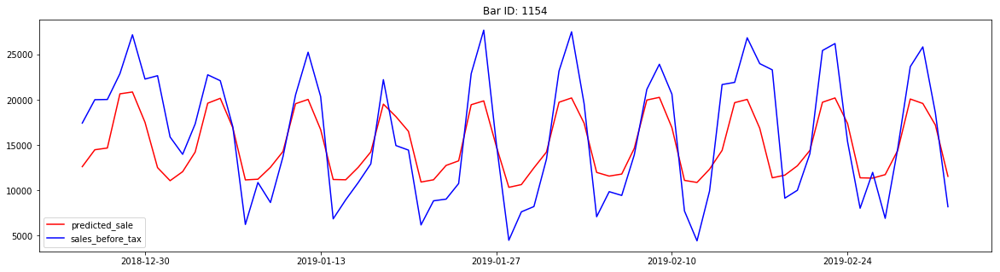

RMS Error:  1580.3397131106763
Corr. Coef. =  86.1206015518396


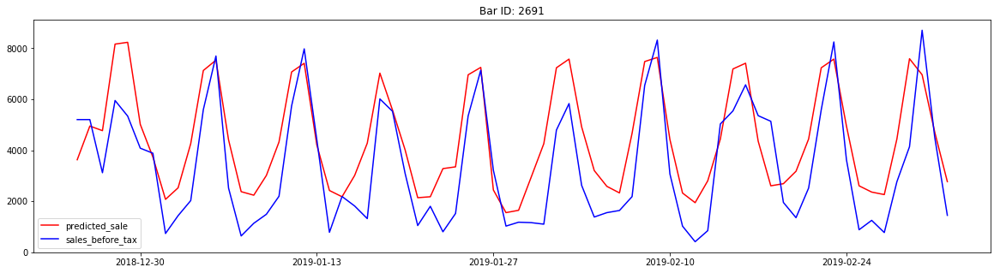

RMS Error:  3147.891200784197
Corr. Coef. =  85.50603169520679


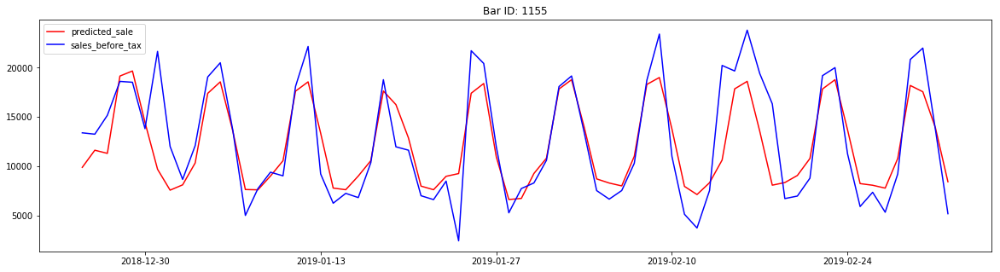

RMS Error:  3540.52790243669
Corr. Coef. =  84.42427501794292


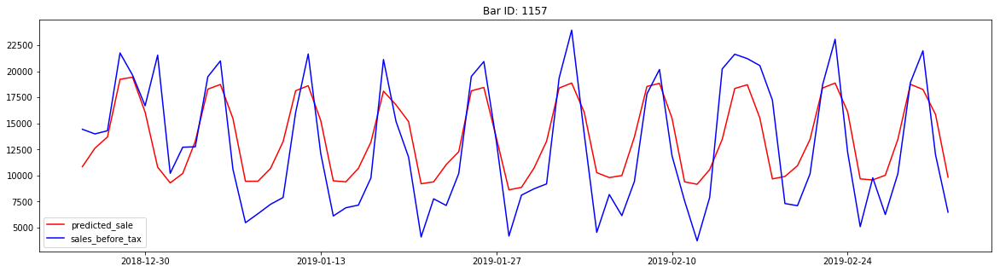

RMS Error:  4113.836338423673
Corr. Coef. =  85.1665222265443


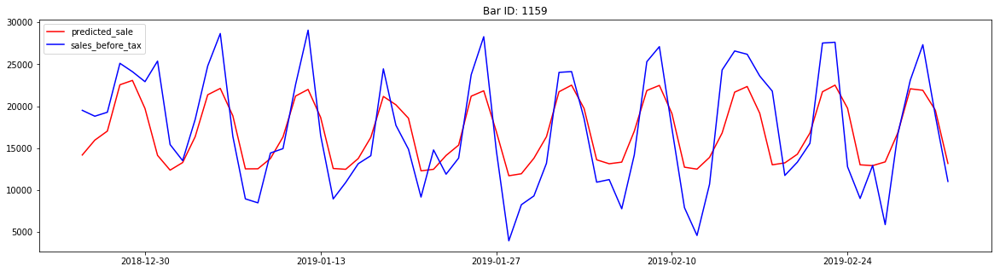

RMS Error:  1394.6936592384232
Corr. Coef. =  80.4684386741793


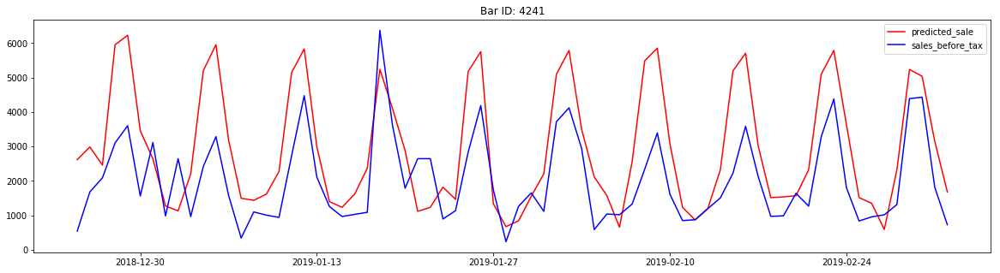

RMS Error:  2699.9119817702576
Corr. Coef. =  88.05678884569717


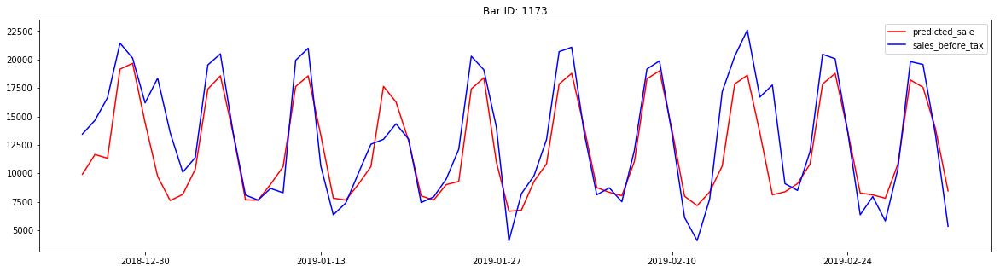

RMS Error:  6711.144276449027
Corr. Coef. =  70.13347934344273


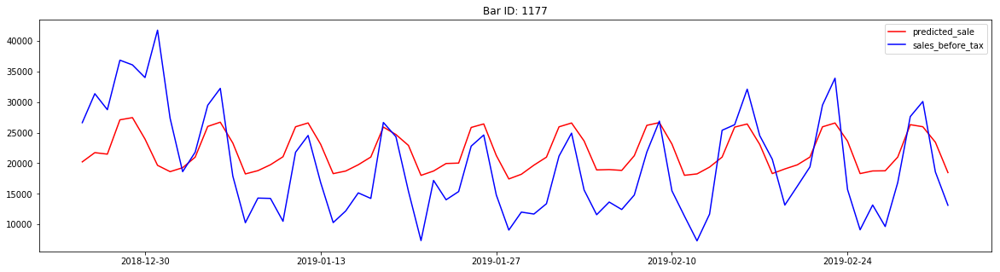

RMS Error:  2564.697989781591
Corr. Coef. =  82.68322963014609


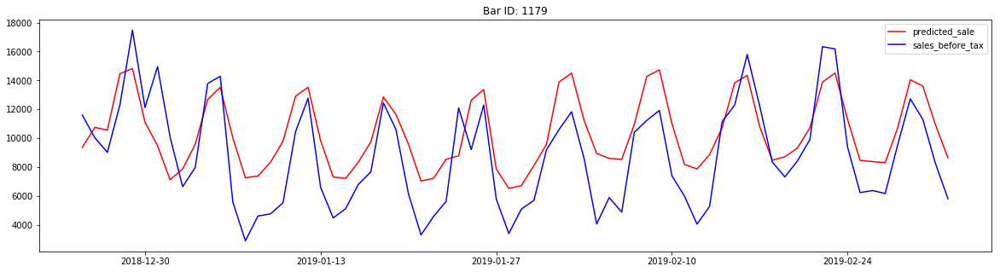

RMS Error:  4785.132585169298
Corr. Coef. =  29.4989840536767


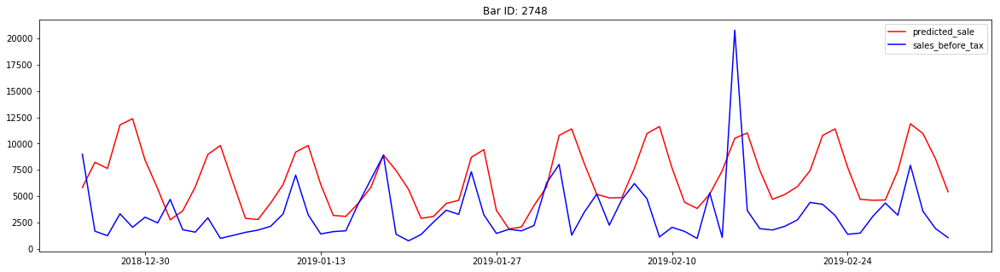

RMS Error:  1581.2841494197314
Corr. Coef. =  84.1054233039494


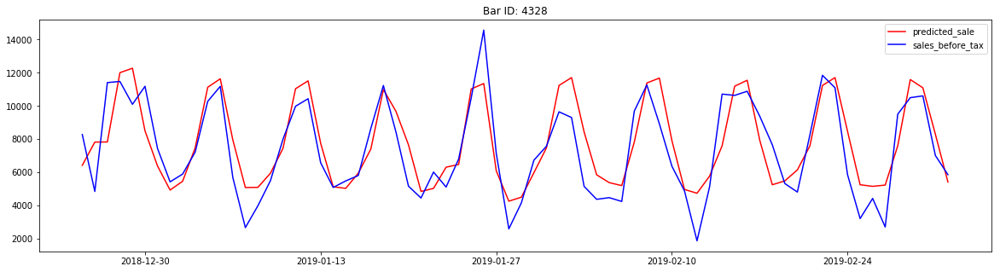

RMS Error:  1755.6639373993871
Corr. Coef. =  72.98014148701414


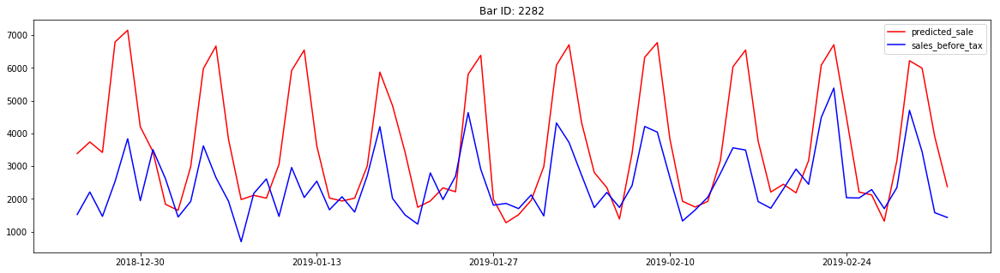

RMS Error:  5014.8145611596565
Corr. Coef. =  67.88770793436615


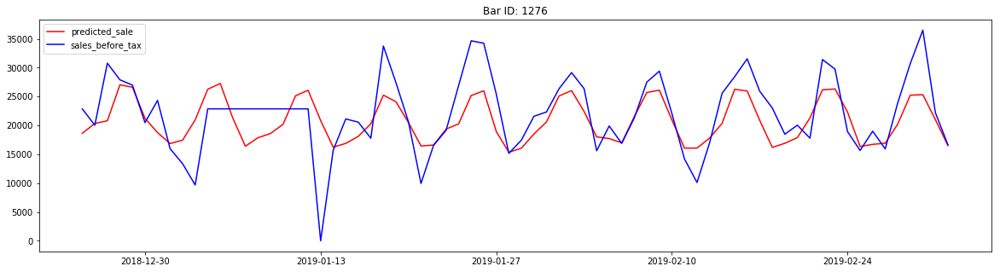

RMS Error:  4048.325887578271
Corr. Coef. =  82.40976447267114


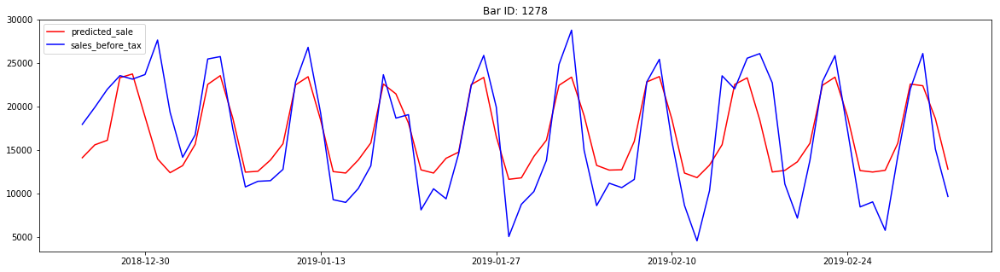

RMS Error:  14750.903946497854
Corr. Coef. =  58.5559115010189


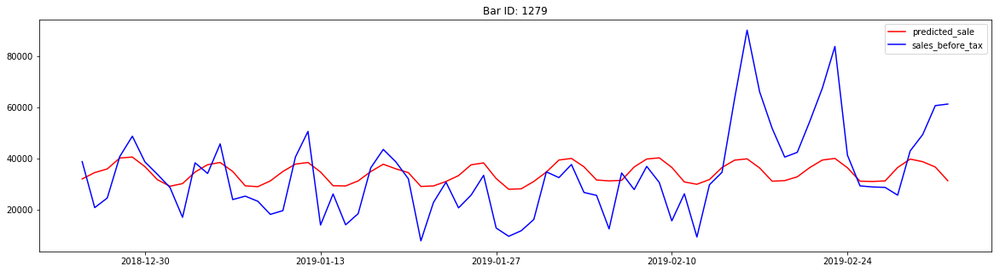

RMS Error:  1833.9194366507777
Corr. Coef. =  46.45452101564487


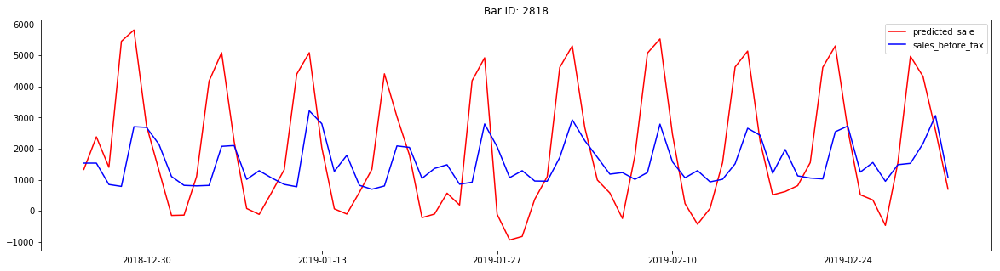

RMS Error:  2422.773483544623
Corr. Coef. =  71.55433397176661


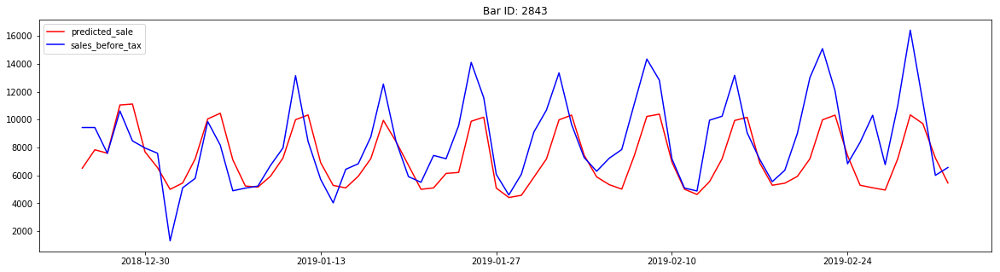

RMS Error:  1405.15096903609
Corr. Coef. =  63.15172491875494


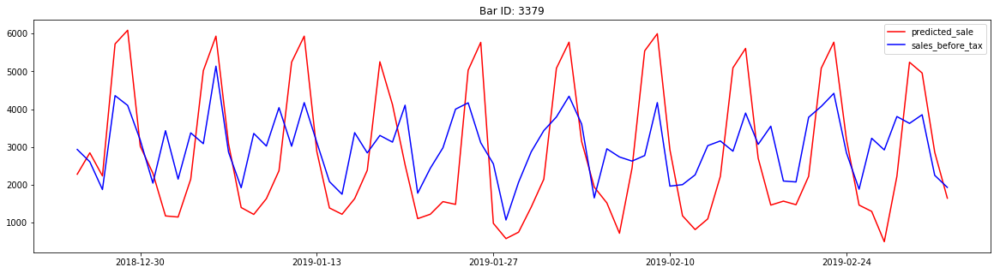

RMS Error:  4026.1464515705543
Corr. Coef. =  38.75762463049752


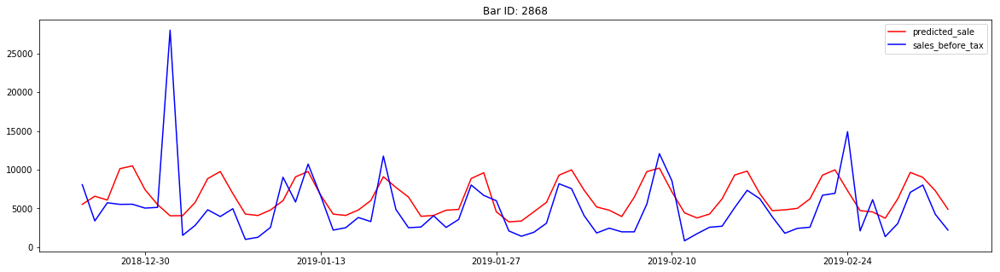

RMS Error:  2194.4227381976284
Corr. Coef. =  48.11153637069131


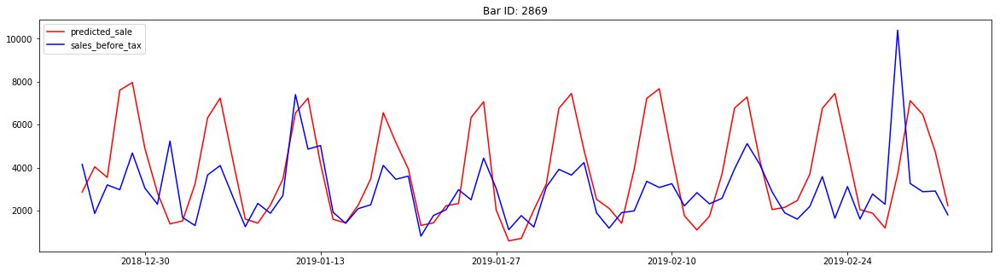

RMS Error:  2863.880044541284
Corr. Coef. =  15.273066086331061


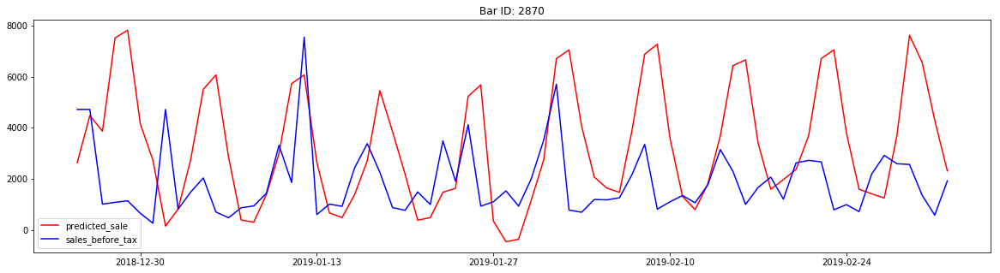

RMS Error:  1526.6912325206147
Corr. Coef. =  75.79691422334533


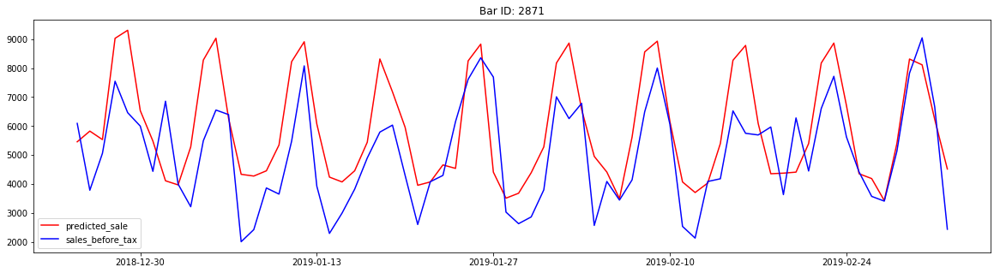

RMS Error:  1726.4042117891756
Corr. Coef. =  61.84344780800022


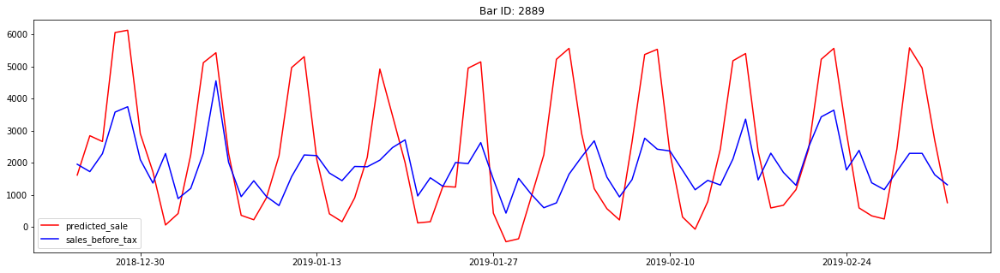

RMS Error:  2148.157458032549
Corr. Coef. =  35.77802796942561


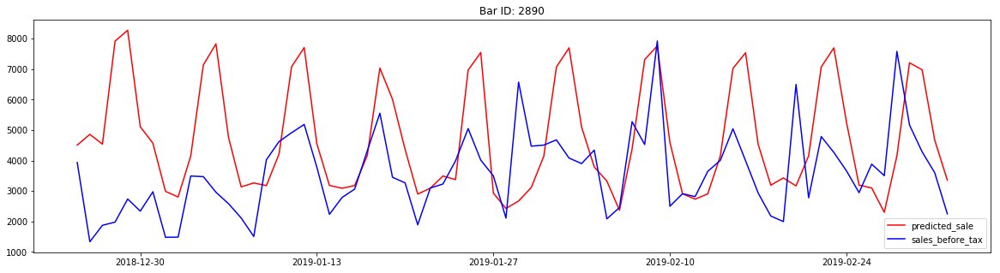

RMS Error:  2198.130657909199
Corr. Coef. =  69.90420690467751


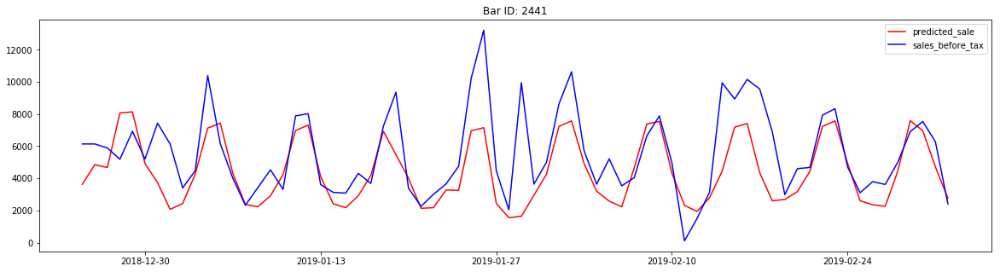

RMS Error:  2147.5231752457257
Corr. Coef. =  62.045419617316874


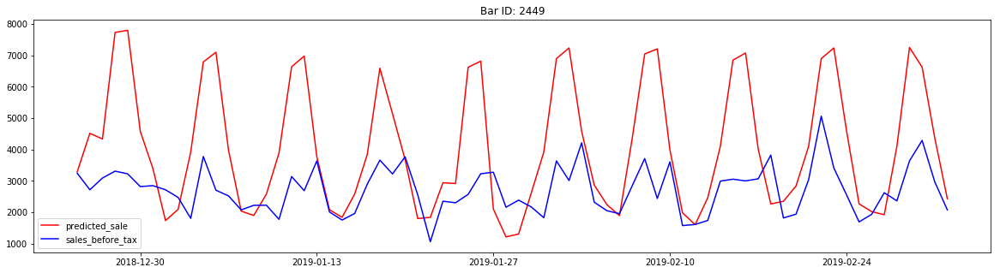

RMS Error:  2186.859246898884
Corr. Coef. =  73.73079913950824


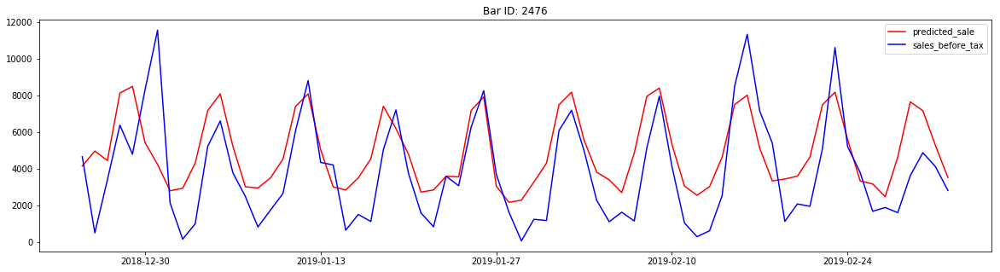

RMS Error:  5523.70685792377
Corr. Coef. =  68.06780942681064


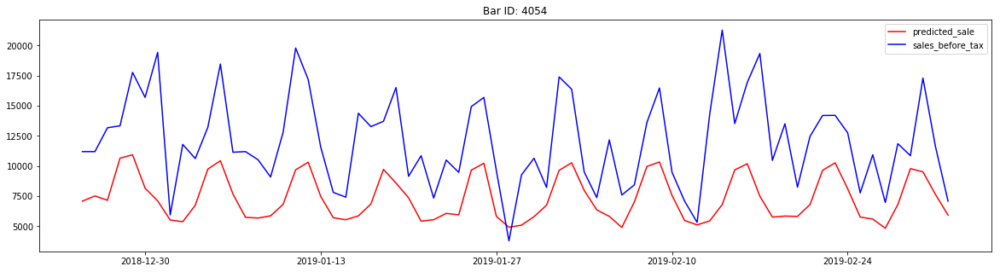

RMS Error:  1635.2106829239906
Corr. Coef. =  75.27251340737013


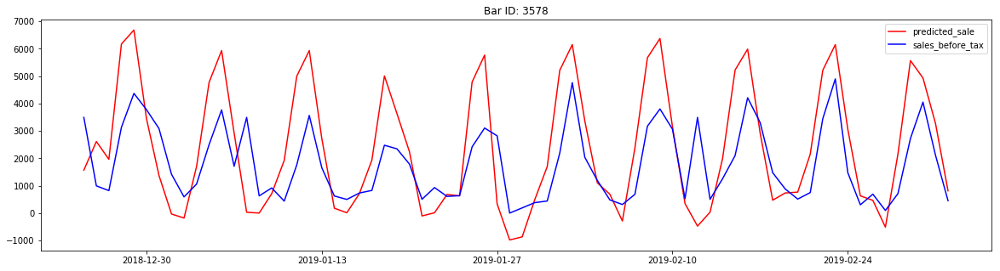

In [46]:
# bar_dict_preds_lastyear = {str(k): [] for k in (last_bar_list)}
df_preds_lastyear = pd.DataFrame()
rmse_list = []
ccoef_list = []
start = df_test.index[0]-pd.DateOffset(years=1)
end = df_test.index[-1]-pd.DateOffset(years=1)

for bar in last_bar_list:

##############################################################################
##################       PREDICT FOR ALL BARS             ####################
##############################################################################

    test = df_test[df_test['bar_id']== int(bar)]
    test = test.dropna()
    test = test[~test.isin(['nan']).any(axis=1)]
    y_ts = test[target]
    test = test[aa]
    X_ts = test
    X_ts = scaler.transform(X_ts)
    predictions = clf.predict(X_ts)
    test['predicted_sale'] = predictions
    
    #############
    lastyear = df_train[df_train['bar_id']== int(bar)]['sales_before_tax']
    lastyear = lastyear[((lastyear.index >= start)&(lastyear.index <= end))]
    tmp = lastyear.reset_index()

    test1 = test[['predicted_sale']]
    test1['last_year_date'] = tmp['order_time'].values
    test1['last_year_sale'] = tmp['sales_before_tax'].values
    df_preds_lastyear = pd.concat([df_preds_lastyear,test1], axis=0)

    ##############

    plt.plot(test['predicted_sale'],'r' )
    plt.plot(y_ts['sales_before_tax'],'b')

    rmse = sqrt(mean_squared_error(y_ts['sales_before_tax'].values, predictions))
    ccoef = 100*np.corrcoef(y_ts['sales_before_tax'].values.T,predictions.T)[0,1]
    rmse_list.append(rmse)
    ccoef_list.append(ccoef)
    
    print('RMS Error: ',rmse)
    print('Corr. Coef. = ',ccoef)    

    plt.title('Bar ID: '+str(bar))
    plt.legend()
    plt.show()

In [47]:
np.mean(ccoef_list)
np.mean(rmse_list)

3164.664375597293

In [48]:
df_preds_lastyear.head()

,predicted_sale,last_year_date,last_year_sale
order_time,,,
2018-12-25,1469.430664,2017-12-25,964.749031
2018-12-26,2301.878662,2017-12-26,1398.110000
2018-12-27,923.498962,2017-12-27,1891.580000
2018-12-28,2927.656250,2017-12-28,1681.580000
2018-12-29,3195.349854,2017-12-29,1233.400000


## Prepare corresponding data for last year

In [49]:
df_preds_lastyear_weekly = df_preds_lastyear.resample("w").agg({'predicted_sale':np.sum,'last_year_sale':np.sum,'last_year_date':'last'})
df_preds_lastyear_monthly = df_preds_lastyear.resample("m").agg({'predicted_sale':np.sum,'last_year_sale':np.sum,'last_year_date':'last'})

df_preds_lastyear_monthly.head(20)


,predicted_sale,last_year_sale,last_year_date
order_time,,,
2018-12-31,2443475.500,2.466644e+06,2017-12-31
2019-01-31,9050201.000,8.525310e+06,2018-01-31
2019-02-28,8815611.000,8.711171e+06,2018-02-28
2019-03-31,1439269.125,1.516075e+06,2018-03-04


# Feature Importance

## Based on correlation coefficient

In [673]:
target+ ['bar_id']

['sales_before_tax', 'bar_id']

In [674]:
target = ['sales_before_tax']
columns = df_last.columns.tolist()
aa = [x for x in columns if x not in target+['bar_id']]
aa

['lat',
 'lon',
 'Month',
 'Max Temp (°C)',
 'Min Temp (°C)',
 'Mean Temp (°C)',
 'Total Precip (mm)',
 'Snow on Grnd (cm)',
 'day_of_week',
 'events']

In [669]:
target = ['sales_before_tax']
columns = df_last.columns.tolist()
aa = [x for x in columns if x not in target+['bar_id']]

natt = 5   # This is the number of features to remove from inputs. 

atts=list(set(itertools.combinations(aa, natt)))

with open('remove'+'_'+str(natt)+'.txt', "w") as afile:
    afile.write('======================================================================================================'+'\n')
    afile.write('======================================================================================================'+'\n')

    print('======================================================================================================')
    print('                                   Target is:    ', target)
    print('======================================================================================================')
    for idx,att in enumerate(atts):

        print('Used curves:    ', att)
        afile.write('#################'+'\n')
        afile.write('Used curves :'+'\n')
        afile.write(str(att)+'\n\n')
        afile.write('Average accuracy :'+'\n')
        ccoef = train_xgb(df_train, df_test, list(att))
        if idx == 0:
            max_corr = ccoef
        if ccoef >= max_corr:
            max_corr = ccoef
            best_features = att
        afile.write(str(ccoef)+'\n')
        afile.write('\n\n\n\n')
        afile.write('#################'+'\n')


                                   Target is:     ['sales_before_tax']
Used curves:     ('sales_before_tax', 'Max Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  87.96839230392443
Corr. Coef. =  99.9947797918117
Used curves:     ('lon', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'day_of_week')
RMS Error:  4127.281512294151
Corr. Coef. =  88.09981147682767
Used curves:     ('lat', 'lon', 'Month', 'Min Temp (°C)', 'events')
RMS Error:  5341.370263066736
Corr. Coef. =  80.61485145283778
Used curves:     ('lat', 'Month', 'Max Temp (°C)', 'Mean Temp (°C)', 'events')
RMS Error:  5078.077604587168
Corr. Coef. =  81.2190507957376
Used curves:     ('sales_before_tax', 'lat', 'Min Temp (°C)', 'Mean Temp (°C)', 'events')
RMS Error:  88.0713295648986
Corr. Coef. =  99.99476887466922
Used curves:     ('Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)')
RMS Error:  8693.950018549409
Corr. Coef. =  1.8606928271752081
Used curves:     

RMS Error:  4267.5892511596185
Corr. Coef. =  87.57661895457868
Used curves:     ('sales_before_tax', 'lon', 'Month', 'Mean Temp (°C)', 'Total Precip (mm)')
RMS Error:  87.48572663118185
Corr. Coef. =  99.99483536759256
Used curves:     ('lat', 'lon', 'Month', 'Min Temp (°C)', 'Total Precip (mm)')
RMS Error:  4822.2329202047185
Corr. Coef. =  82.91370886327302
Used curves:     ('sales_before_tax', 'lat', 'Max Temp (°C)', 'Min Temp (°C)', 'Snow on Grnd (cm)')
RMS Error:  88.2764408393833
Corr. Coef. =  99.99474601177847
Used curves:     ('lat', 'lon', 'Month', 'Mean Temp (°C)', 'day_of_week')
RMS Error:  3981.9393549487527
Corr. Coef. =  88.82844693491214
Used curves:     ('Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  8726.61369600439
Corr. Coef. =  1.4382082375148189
Used curves:     ('lat', 'lon', 'Max Temp (°C)', 'day_of_week', 'events')
RMS Error:  4151.6668317406675
Corr. Coef. =  88.25407417293614
Used curves:     ('sales_before_tax', 'lat',

RMS Error:  88.1213173879601
Corr. Coef. =  99.99476475268894
Used curves:     ('sales_before_tax', 'Month', 'Min Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)')
RMS Error:  87.18679659381503
Corr. Coef. =  99.99487230412319
Used curves:     ('sales_before_tax', 'lat', 'Max Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week')
RMS Error:  88.1213173879601
Corr. Coef. =  99.99476475268894
Used curves:     ('lat', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'day_of_week')
RMS Error:  4397.597162767436
Corr. Coef. =  86.95816699859064
Used curves:     ('sales_before_tax', 'Month', 'Max Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)')
RMS Error:  87.48572663118185
Corr. Coef. =  99.99483536759256
Used curves:     ('lat', 'Month', 'Min Temp (°C)', 'Total Precip (mm)', 'day_of_week')
RMS Error:  4340.604561532546
Corr. Coef. =  86.93746612904751
Used curves:     ('sales_before_tax', 'lon', 'Max Temp (°C)', 'Min Temp (°C)', 'day_of_week')
RMS Error:  88.2764408393833
Corr. Coef.

RMS Error:  88.36667024227827
Corr. Coef. =  99.99473478874268
Used curves:     ('lon', 'Max Temp (°C)', 'Min Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  5216.596313724226
Corr. Coef. =  80.11631480698031
Used curves:     ('Month', 'Max Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'events')
RMS Error:  8679.992925212957
Corr. Coef. =  5.1273713869706254
Used curves:     ('sales_before_tax', 'lat', 'Max Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  87.96839230392443
Corr. Coef. =  99.9947797918117
Used curves:     ('sales_before_tax', 'lon', 'Min Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)')
RMS Error:  88.36667024227827
Corr. Coef. =  99.99473478874268
Used curves:     ('sales_before_tax', 'lat', 'Month', 'Mean Temp (°C)', 'day_of_week')
RMS Error:  87.43532946007342
Corr. Coef. =  99.99484004862876
Used curves:     ('sales_before_tax', 'Month', 'Min Temp (°C)', 'Mean Temp (°C)', 'day_of_week')
RMS Error:  87.46342915669656
Corr. Coef. =  99.9948379

RMS Error:  88.19011846660132
Corr. Coef. =  99.9947561561956
Used curves:     ('sales_before_tax', 'Month', 'Max Temp (°C)', 'Mean Temp (°C)', 'day_of_week')
RMS Error:  87.48021735961295
Corr. Coef. =  99.99483613978146
Used curves:     ('lat', 'Month', 'Mean Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  5025.8860713612
Corr. Coef. =  81.80725868360848
Used curves:     ('lon', 'Min Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  5181.640174202224
Corr. Coef. =  80.46314104450765
Used curves:     ('lon', 'Mean Temp (°C)', 'Total Precip (mm)', 'day_of_week', 'events')
RMS Error:  4266.003769739582
Corr. Coef. =  87.5503410690476
Used curves:     ('sales_before_tax', 'lon', 'Min Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)')
RMS Error:  88.19011846660132
Corr. Coef. =  99.9947561561956
Used curves:     ('lon', 'Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'day_of_week')
RMS Error:  4283.555998169229
Corr. Coef. =  87.47529200337378
Used curves

RMS Error:  88.36667024227827
Corr. Coef. =  99.99473478874268
Used curves:     ('lon', 'Month', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'day_of_week')
RMS Error:  4125.14550879556
Corr. Coef. =  88.01739362442706
Used curves:     ('lat', 'lon', 'Min Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week')
RMS Error:  4168.995928867401
Corr. Coef. =  88.07733077091609
Used curves:     ('lon', 'Month', 'Max Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week')
RMS Error:  4135.470516374621
Corr. Coef. =  88.08896060732665
Used curves:     ('lat', 'Min Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)', 'events')
RMS Error:  5161.928848858013
Corr. Coef. =  80.83942828937573
Used curves:     ('Month', 'Min Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week', 'events')
RMS Error:  8537.39449197882
Corr. Coef. =  23.209047118884023
Used curves:     ('Month', 'Mean Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week', 'events')
RMS Error:  8405.689937220923
Corr. Coef. =  25.351961769662584
Used curves:     ('sales

RMS Error:  87.89743779932313
Corr. Coef. =  99.99478954201854
Used curves:     ('sales_before_tax', 'Max Temp (°C)', 'Min Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)')
RMS Error:  88.36667024227827
Corr. Coef. =  99.99473478874268
Used curves:     ('sales_before_tax', 'lon', 'Month', 'Max Temp (°C)', 'Mean Temp (°C)')
RMS Error:  87.48021735961295
Corr. Coef. =  99.99483613978146
Used curves:     ('sales_before_tax', 'lat', 'lon', 'Snow on Grnd (cm)', 'events')
RMS Error:  88.0025390102644
Corr. Coef. =  99.99477683209007
Used curves:     ('Max Temp (°C)', 'Min Temp (°C)', 'Total Precip (mm)', 'day_of_week', 'events')
RMS Error:  8322.34064294469
Corr. Coef. =  27.221928563251552
Used curves:     ('sales_before_tax', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Snow on Grnd (cm)')
RMS Error:  87.34765979412992
Corr. Coef. =  99.99485163518666
Used curves:     ('lat', 'lon', 'Month', 'Max Temp (°C)', 'Snow on Grnd (cm)')
RMS Error:  4918.139160289391
Corr. Coef. =  82.2050261388

RMS Error:  87.88656858978399
Corr. Coef. =  99.9947905286149
Used curves:     ('sales_before_tax', 'Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)')
RMS Error:  88.2764408393833
Corr. Coef. =  99.99474601177847
Used curves:     ('sales_before_tax', 'Max Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'events')
RMS Error:  87.89743779932313
Corr. Coef. =  99.99478954201854
Used curves:     ('sales_before_tax', 'lat', 'Min Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week')
RMS Error:  88.2651512840875
Corr. Coef. =  99.99474839839792
Used curves:     ('lat', 'lon', 'Month', 'Max Temp (°C)', 'events')
RMS Error:  4931.577151880118
Corr. Coef. =  82.21518586158648
Used curves:     ('lat', 'lon', 'Min Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)')
RMS Error:  5063.320677236093
Corr. Coef. =  81.32525406033754
Used curves:     ('sales_before_tax', 'lat', 'Max Temp (°C)', 'Total Precip (mm)', 'events')
RMS Error:  87.89743779932313
Corr. Coef. =  99.99478954201854


RMS Error:  87.18679659381503
Corr. Coef. =  99.99487230412319
Used curves:     ('sales_before_tax', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'day_of_week')
RMS Error:  87.34765979412992
Corr. Coef. =  99.99485163518666
Used curves:     ('lat', 'lon', 'Month', 'Max Temp (°C)', 'day_of_week')
RMS Error:  3993.128952587112
Corr. Coef. =  88.80325208755765
Used curves:     ('lat', 'Max Temp (°C)', 'Mean Temp (°C)', 'day_of_week', 'events')
RMS Error:  4407.853892886243
Corr. Coef. =  86.95619082442654
Used curves:     ('sales_before_tax', 'lon', 'Min Temp (°C)', 'Mean Temp (°C)', 'events')
RMS Error:  88.0713295648986
Corr. Coef. =  99.99476887466922
Used curves:     ('sales_before_tax', 'lat', 'Month', 'Max Temp (°C)', 'day_of_week')
RMS Error:  87.34765979412992
Corr. Coef. =  99.99485163518666
Used curves:     ('sales_before_tax', 'lat', 'Min Temp (°C)', 'Total Precip (mm)', 'events')
RMS Error:  87.88656858978399
Corr. Coef. =  99.9947905286149
Used curves:     ('sales_before_tax', 

### Just this one is using the new hockey games:

In [507]:
print(max_corr)
print(best_features)

79.94580942537117
('lat', 'lon', 'Month', 'Total Precip (mm)', 'day_of_week')


### The rest is without hockey info:

In [452]:
print(max_corr)
print(best_features)

72.21127728761464
('day_of_week',)


In [454]:
print(max_corr)
print(best_features)

75.9853218454202
('lon', 'day_of_week')


In [456]:
print(max_corr)
print(best_features)

78.82469314405762
('lon', 'Month', 'day_of_week')


In [450]:
print(max_corr)
print(best_features)

79.17240855512642
('lat', 'lon', 'Month', 'day_of_week')


In [458]:
print(max_corr)
print(best_features)

79.94580942537117
('lat', 'lon', 'Month', 'Total Precip (mm)', 'day_of_week')


In [460]:
print(max_corr)
print(best_features)

79.52613205982783
('lat', 'lon', 'Month', 'Total Precip (mm)', 'day_of_week', 'events')


## Based on RMSE

In [101]:
target = ['sales_before_tax']
columns = df_last.columns.tolist()
# aa = [x for x in columns if x not in target]
aa = [x for x in columns if x not in target+['bar_id']]

natt = 8   # This is the number of features to remove from inputs. 

atts=list(set(itertools.combinations(aa, natt)))

with open('remove'+'_'+str(natt)+'.txt', "w") as afile:
    afile.write('======================================================================================================'+'\n')
    afile.write('======================================================================================================'+'\n')

    print('======================================================================================================')
    print('                                   Target is:    ', target)
    print('======================================================================================================')
    for idx,att in enumerate(atts):

        print('Used curves:    ', att)
        afile.write('#################'+'\n')
        afile.write('Used curves :'+'\n')
        afile.write(str(att)+'\n\n')
        afile.write('Average error :'+'\n')
        rmse = train_xgb(df_train, df_test, list(att))
        if idx == 0:
            min_rmse = rmse
        if rmse <= min_rmse:
            min_rmse = rmse
            best_features = att
        afile.write(str(rmse)+'\n')
        afile.write('\n\n\n\n')
        afile.write('#################'+'\n')


                                   Target is:     ['sales_before_tax']
Used curves:     ('lon', 'Month', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'day_of_week', 'events')
RMS Error:  4096.570964899462
Corr. Coef. =  88.3313825450777
Used curves:     ('lat', 'lon', 'Month', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'day_of_week', 'events')
RMS Error:  4049.0933932142793
Corr. Coef. =  88.74830217191239
Used curves:     ('lat', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'day_of_week', 'events')
RMS Error:  4400.325501771579
Corr. Coef. =  87.039146938992
Used curves:     ('lat', 'lon', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'events')
RMS Error:  4930.869336947486
Corr. Coef. =  82.66283567415128
Used curves:     ('lat', 'lon', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)')
RMS Error:  4857.8888684036

RMS Error:  4113.319110916475
Corr. Coef. =  88.23799075465753
Used curves:     ('lat', 'lon', 'Month', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'events')
RMS Error:  4828.895340907818
Corr. Coef. =  83.1741043868207
Used curves:     ('lon', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'events')
RMS Error:  5024.493887678398
Corr. Coef. =  82.11581087314991
Used curves:     ('lat', 'lon', 'Month', 'Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Snow on Grnd (cm)', 'day_of_week')
RMS Error:  3979.288151921741
Corr. Coef. =  88.87635909696179


In [86]:
print(min_rmse)
print(best_features)

5278.784031677611
('lat',)


In [88]:
print(min_rmse)
print(best_features)

4531.478576411294
('lon', 'day_of_week')


In [90]:
print(min_rmse)
print(best_features)

4077.97134244418
('lon', 'Month', 'day_of_week')


In [92]:
print(min_rmse)
print(best_features)

4005.731219948182
('lat', 'lon', 'Month', 'day_of_week')


In [94]:
print(min_rmse)
print(best_features)

3981.939354948752
('lat', 'lon', 'Month', 'Mean Temp (°C)', 'day_of_week')


In [96]:
print(min_rmse)
print(best_features)

3968.557677314088
('lat', 'lon', 'Month', 'Mean Temp (°C)', 'Total Precip (mm)', 'day_of_week')


In [98]:
print(min_rmse)
print(best_features)

3915.7803641193273
('lat', 'lon', 'Month', 'Max Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'day_of_week')


In [102]:
print(min_rmse)
print(best_features)

3915.7803641193273
('lat', 'lon', 'Month', 'Max Temp (°C)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'day_of_week', 'events')


# Bars Like You

## Based on Correlation Coefficient

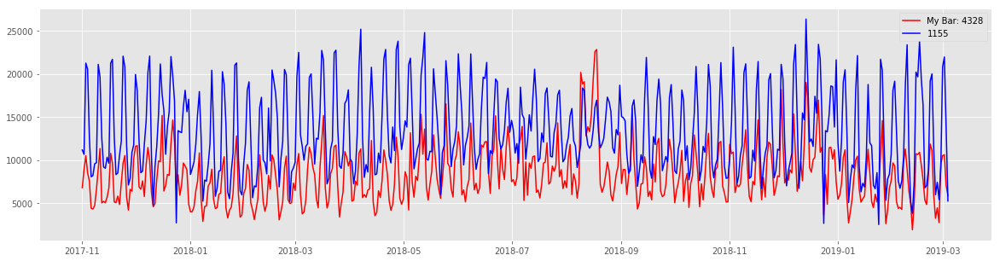

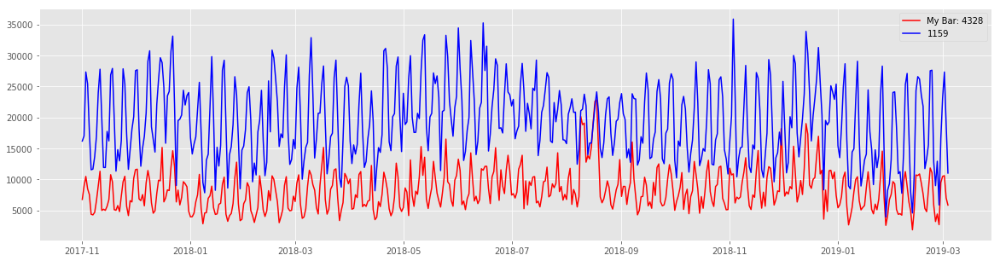

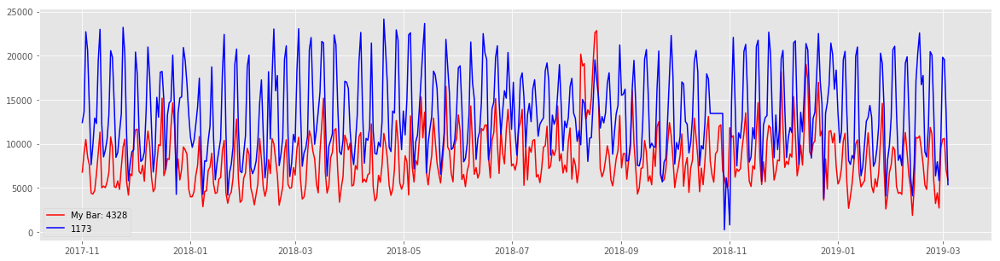

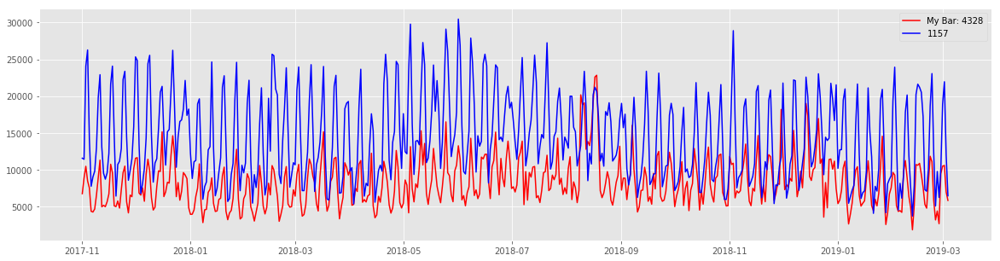

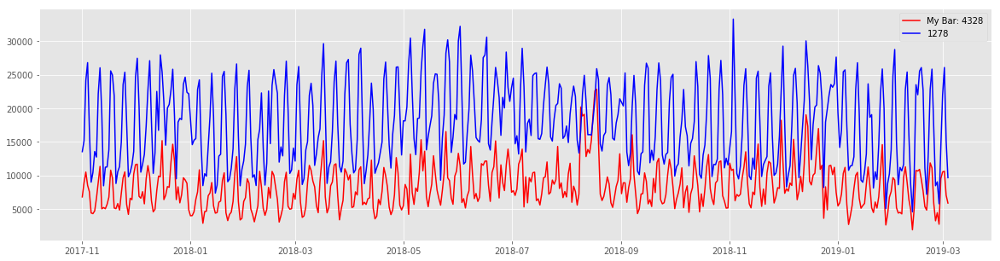

...

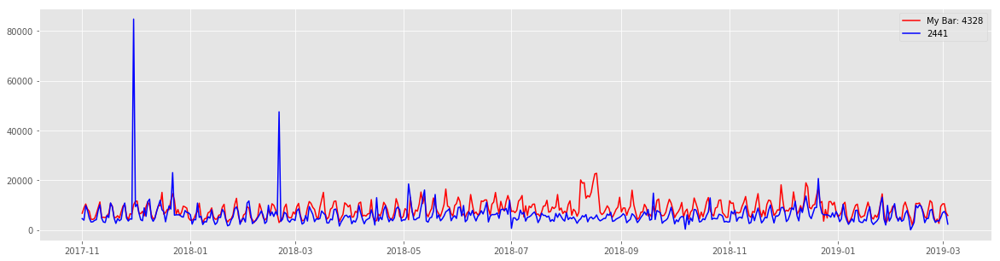

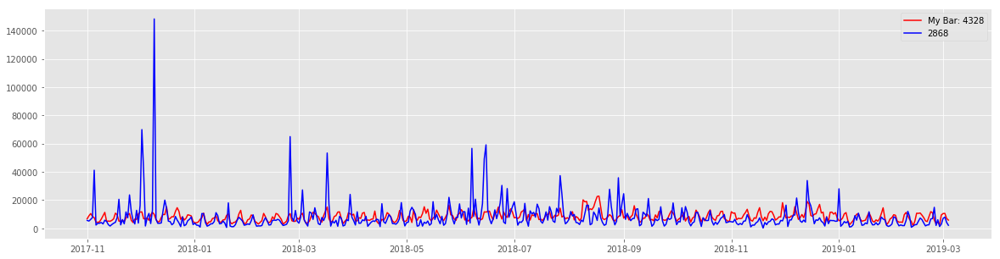

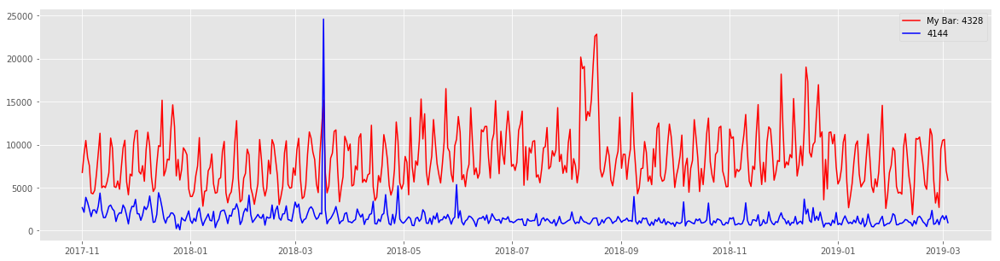

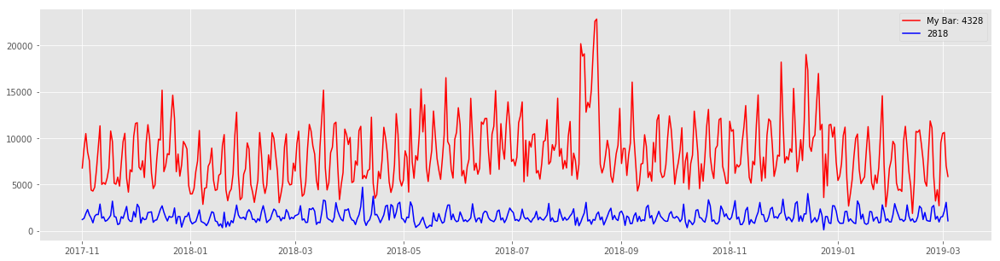

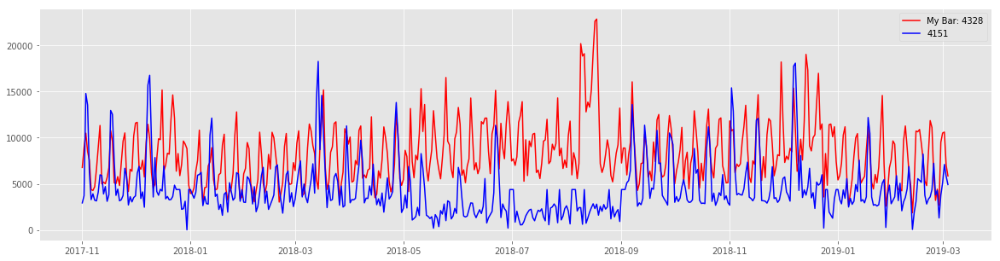

In [579]:
#  CCOEF
target_bar_id = '4328'
blu1, ccoef_list1, rmse_list1 = bar_finder_ccoef(target_bar_id, new_bar_dict2)
plot_blu(target_bar_id, blu1, new_bar_dict2)

## Based on RMS Error

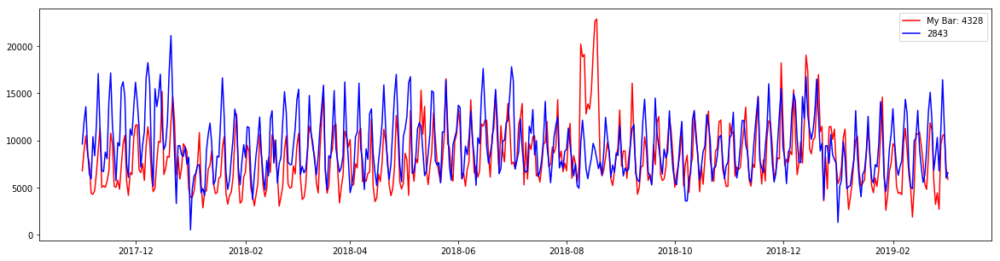

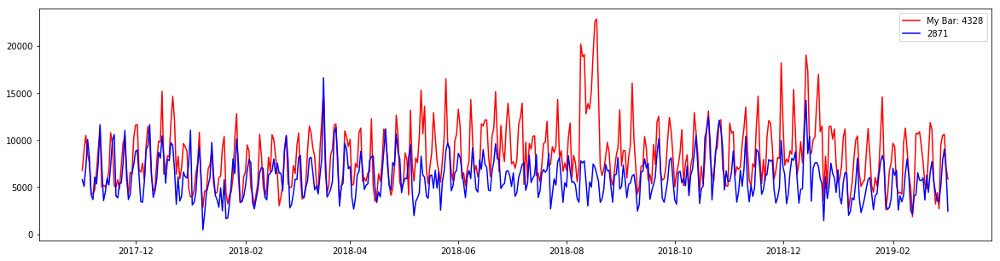

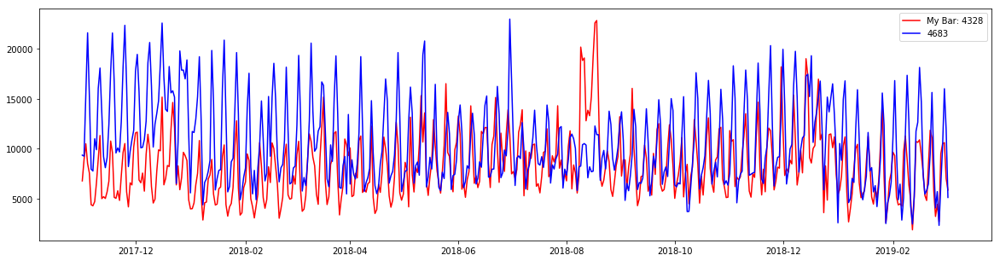

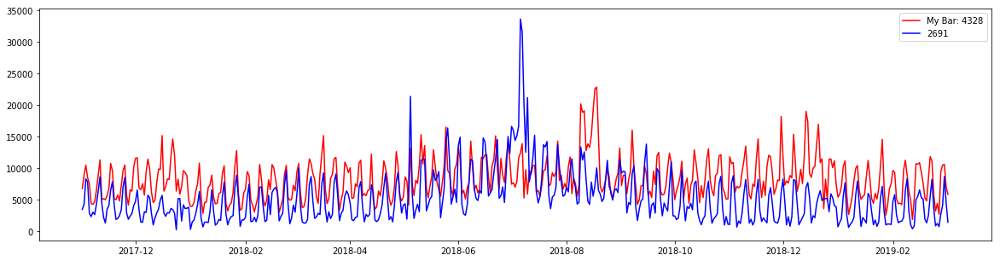

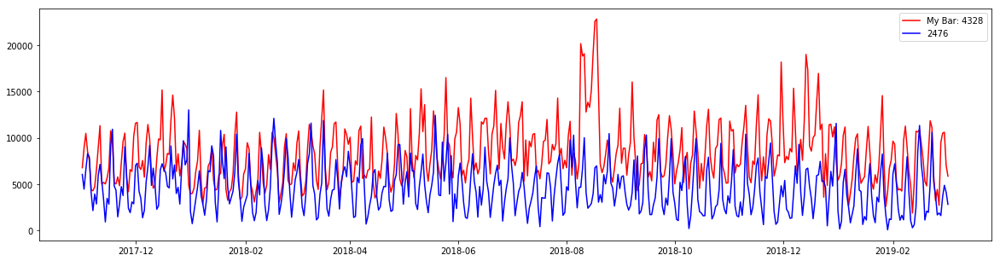

...

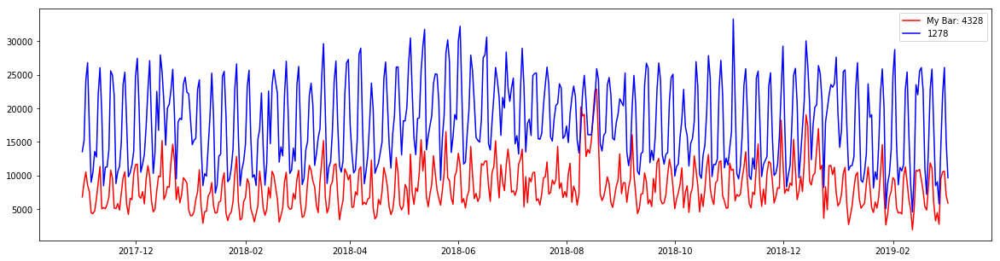

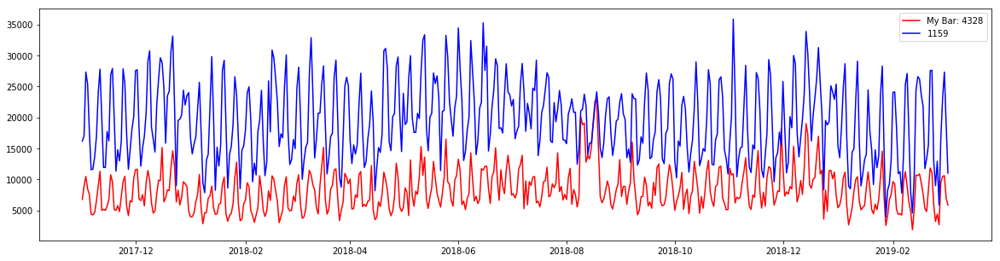

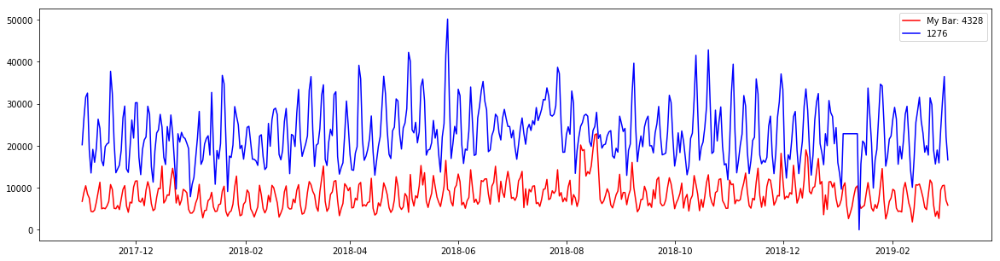

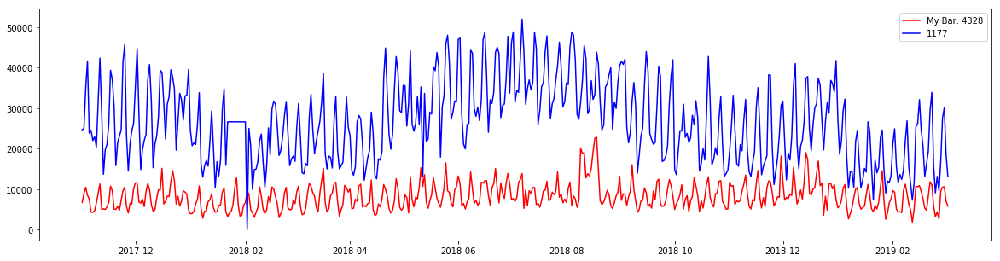

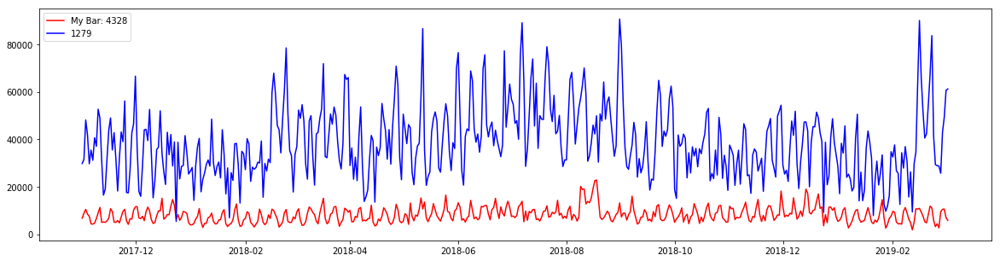

In [66]:
# RMSE
target_bar_id = '4328'
blu1, ccoef_list1, rmse_list1 = bar_finder_rmse(target_bar_id, new_bar_dict2)
plot_blu(target_bar_id, blu1, new_bar_dict2)

## Based on RMS Error and Correlation Coefficient

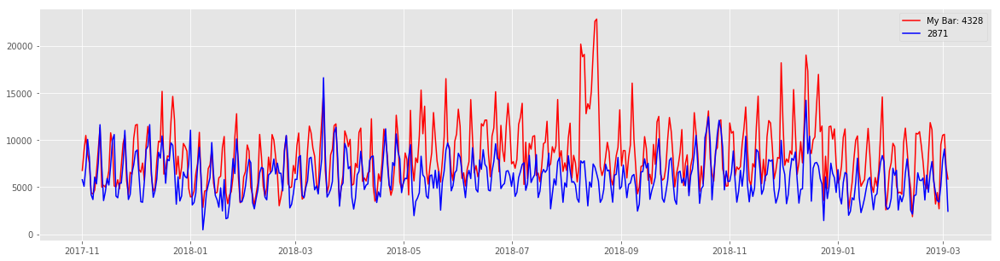

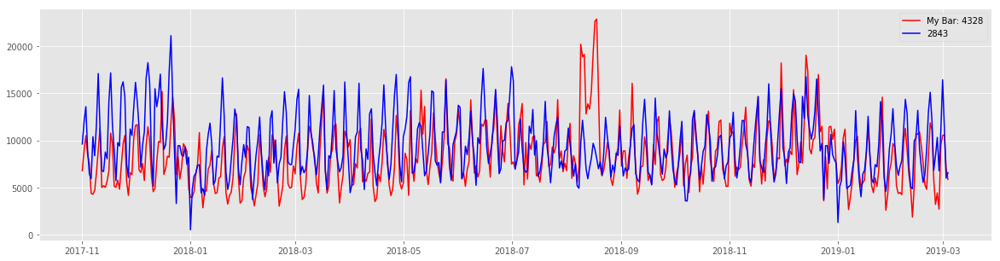

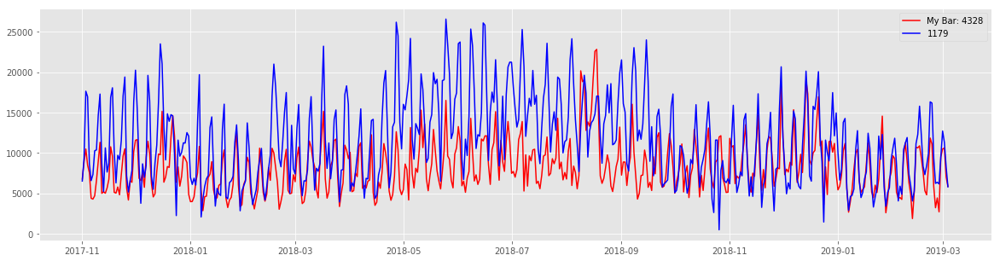

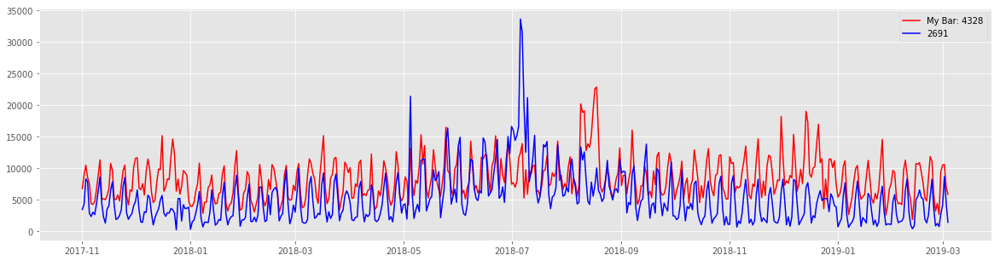

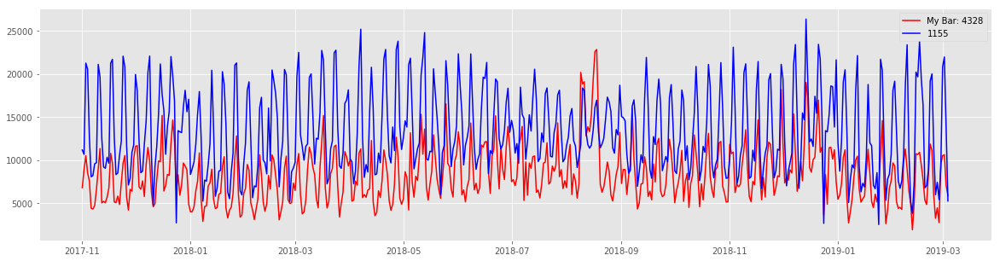

...

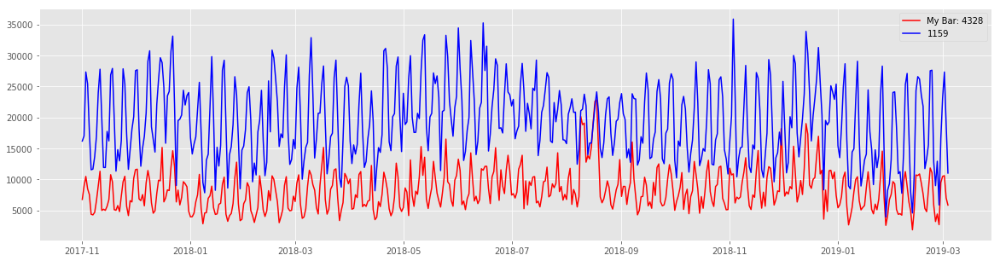

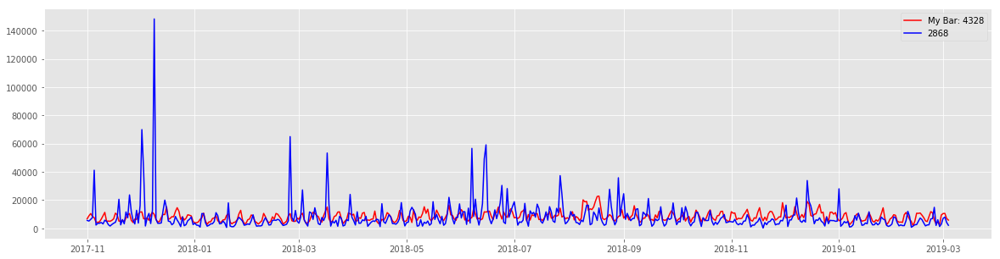

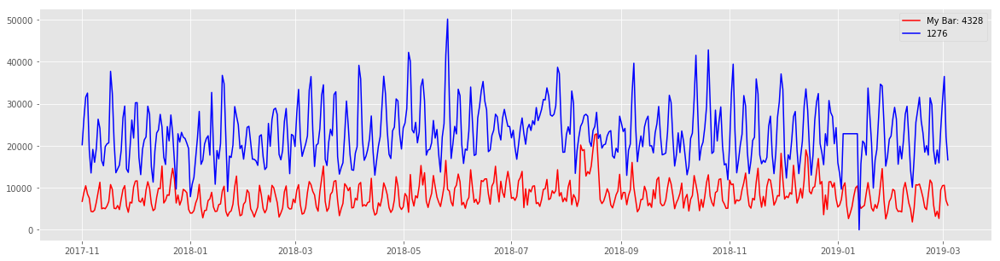

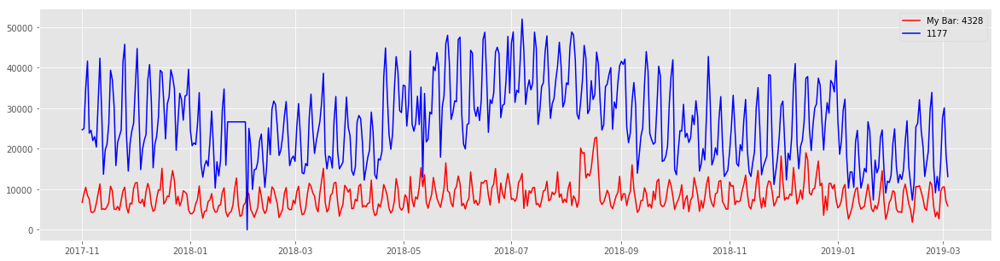

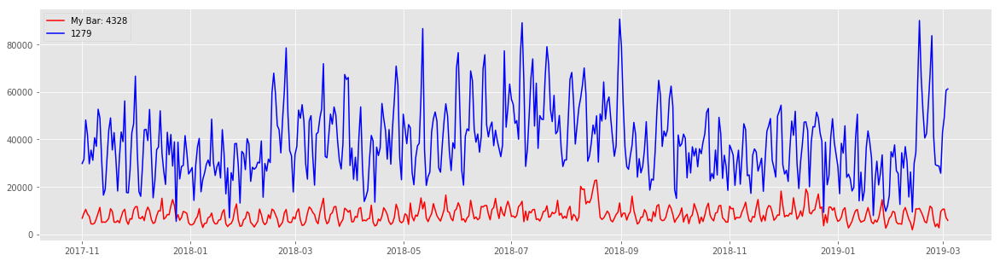

In [635]:
# RMSECCOEF
target_bar_id = '4328'
blu1 = bar_finder_rmseccoef(target_bar_id, new_bar_dict2)
plot_blu(target_bar_id, blu1, new_bar_dict2)

# Aggregate DF to monthly

In [167]:
monthly = pd.DataFrame()
for key in new_bar_dict2.keys():
    a = new_bar_dict2[key][0]
    a = a.resample("m").agg({'sales_before_tax':np.sum,'bar_id':'last'})
    monthly = pd.concat([monthly,a], axis=0)

monthly['bar_id'] = monthly['bar_id'].astype(int)
monthly['sales_before_tax'] = monthly['sales_before_tax'].apply(lambda x: round(x, 2))

In [161]:
from __future__ import print_function # Python 2/3 compatibility
import boto3

dynamodb = boto3.resource('dynamodb', region_name='us-east-1')#, endpoint_url="http://localhost:8000")


table = dynamodb.create_table(
    TableName='BarsLikeYou',
    KeySchema=[
        {
            'AttributeName': 'bar_id',
            'KeyType': 'HASH'  #Partition key
        }
    ],
    AttributeDefinitions=[
        {
            'AttributeName': 'bar_id',
            'AttributeType': 'S'
        }

    ],
    ProvisionedThroughput={
        'ReadCapacityUnits': 10,
        'WriteCapacityUnits': 10
    }
)

print("Table status:", table.table_status)
table = dynamodb.Table('BarsLikeYou')



Table status: CREATING


# Write BLU to Dynamo

In [173]:
bardict = {}
for bar in last_bar_list:
    emptylist = []
    blu1, ccoef_list1, rmse_list1 = bar_finder_rmse(bar, new_bar_dict2)
    submontly = monthly[monthly['bar_id'].isin(blu1[:10]+[bar])]
    for mon in submontly.index.unique():
        sub_submontly = submontly[str(mon)[:10]]
        month = sub_submontly.index[0].strftime("%B %Y")#[:3]
        month = month[:3]+'-'+month[-4:]
        sub_submontly = sub_submontly.to_dict('record')
        sub_dict = {}
        sub_dict['Month']= month
        sub_dict['Data']= sub_submontly
        emptylist.append(sub_dict)
    emptylist = str(emptylist)
    emptylist = emptylist.replace('\'', '"')
#     print(emptylist)
    table.put_item(
           Item={
               'bar_id': str(bar),
               'data': emptylist
            }
        )
    

,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,163211.08,4151
2017-12-31,159838.92,4151
2018-01-31,138597.46,4151
2018-02-28,116407.73,4151
2018-03-31,191836.35,4151


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,163211.08,4151
2017-12-31,159838.92,4151
2018-01-31,138597.46,4151
2018-02-28,116407.73,4151
2018-03-31,191836.35,4151


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,171018.18,3162
2017-12-31,179891.42,3162
2018-01-31,117992.98,3162
2018-02-28,123266.49,3162
2018-03-31,152811.15,3162


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,171018.18,3162
2017-12-31,179891.42,3162
2018-01-31,117992.98,3162
2018-02-28,123266.49,3162
2018-03-31,152811.15,3162


,sales_before_tax,bar_id
2017-11-30,389729.27,4683
2017-12-31,474117.66,4683
2018-01-31,331343.99,4683
2018-02-28,292182.41,4683
2018-03-31,345897.03,4683


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,171018.18,3162
2017-12-31,179891.42,3162
2018-01-31,117992.98,3162
2018-02-28,123266.49,3162
2018-03-31,152811.15,3162


,sales_before_tax,bar_id
2017-11-30,171018.18,3162
2017-12-31,179891.42,3162
2018-01-31,117992.98,3162
2018-02-28,123266.49,3162
2018-03-31,152811.15,3162


,sales_before_tax,bar_id
2017-11-30,163211.08,4151
2017-12-31,159838.92,4151
2018-01-31,138597.46,4151
2018-02-28,116407.73,4151
2018-03-31,191836.35,4151


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,171018.18,3162
2017-12-31,179891.42,3162
2018-01-31,117992.98,3162
2018-02-28,123266.49,3162
2018-03-31,152811.15,3162


,sales_before_tax,bar_id
2017-11-30,163211.08,4151
2017-12-31,159838.92,4151
2018-01-31,138597.46,4151
2018-02-28,116407.73,4151
2018-03-31,191836.35,4151


,sales_before_tax,bar_id
2017-11-30,29725.38,4143
2017-12-31,31754.81,4143
2018-01-31,34640.62,4143
2018-02-28,35849.34,4143
2018-03-31,41895.11,4143


,sales_before_tax,bar_id
2017-11-30,163211.08,4151
2017-12-31,159838.92,4151
2018-01-31,138597.46,4151
2018-02-28,116407.73,4151
2018-03-31,191836.35,4151


,sales_before_tax,bar_id
2017-11-30,497032.04,4676
2017-12-31,549510.99,4676
2018-01-31,365354.38,4676
2018-02-28,336271.64,4676
2018-03-31,396869.70,4676


,sales_before_tax,bar_id
2017-11-30,128238.23,2691
2017-12-31,106762.43,2691
2018-01-31,92577.81,2691
2018-02-28,116037.17,2691
2018-03-31,137628.69,2691
